# Build a Conditional GAN

### Goals
In this notebook, you're going to make a conditional GAN in order to generate hand-written images of digits, conditioned on the digit to be generated (the class vector). This will let you choose what digit you want to generate.

You'll then do some exploration of the generated images to visualize what the noise and class vectors mean.  

### Learning Objectives
1.   Learn the technical difference between a conditional and unconditional GAN.
2.   Understand the distinction between the class and noise vector in a conditional GAN.



## Getting Started

For this assignment, you will be using the MNIST dataset again, but there's nothing stopping you from applying this generator code to produce images of animals conditioned on the species or pictures of faces conditioned on facial characteristics.

Note that this assignment requires no changes to the architectures of the generator or discriminator, only changes to the data passed to both. The generator will no longer take `z_dim` as an argument, but  `input_dim` instead, since you need to pass in both the noise and class vectors. In addition to good variable naming, this also means that you can use the generator and discriminator code you have previously written with different parameters.

You will begin by importing the necessary libraries and building the generator and discriminator.

#### Packages and Visualization

In [1]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for our testing purposes, please do not change!

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28), nrow=5, show=True):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=nrow)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    if show:
        plt.show()

#### Generator and Noise

In [2]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        input_dim: the dimension of the input vector, a scalar
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, input_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.input_dim = input_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(input_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor, 
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, input_dim)
        '''
        x = noise.view(len(noise), self.input_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, input_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, input_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
        n_samples: the number of samples to generate, a scalar
        input_dim: the dimension of the input vector, a scalar
        device: the device type
    '''
    return torch.randn(n_samples, input_dim, device=device)

#### Discriminator

In [3]:
class Discriminator(nn.Module):
    '''
    Discriminator Class
    Values:
      im_chan: the number of channels in the images, fitted for the dataset used, a scalar
            (MNIST is black-and-white, so 1 channel is your default)
      hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            self.make_disc_block(im_chan, hidden_dim),
            self.make_disc_block(hidden_dim, hidden_dim * 2),
            self.make_disc_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_disc_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a discriminator block of the DCGAN; 
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the discriminator: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        disc_pred = self.disc(image)
        return disc_pred.view(len(disc_pred), -1)

## Class Input

In conditional GANs, the input vector for the generator will also need to include the class information. The class is represented using a one-hot encoded vector where its length is the number of classes and each index represents a class. The vector is all 0's and a 1 on the chosen class. Given the labels of multiple images (e.g. from a batch) and number of classes, please create one-hot vectors for each label. There is a class within the PyTorch functional library that can help you.

<details>

<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">get_one_hot_labels</font></code></b>
</font>
</summary>

1.   This code can be done in one line.
2.   The documentation for [F.one_hot](https://pytorch.org/docs/stable/nn.functional.html#torch.nn.functional.one_hot) may be helpful.

</details>


In [4]:
# UNQ_C1 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_one_hot_labels

import torch.nn.functional as F
def get_one_hot_labels(labels, n_classes):
    '''
    Function for creating one-hot vectors for the labels, returns a tensor of shape (?, num_classes).
    Parameters:
        labels: tensor of labels from the dataloader, size (?)
        n_classes: the total number of classes in the dataset, an integer scalar
    '''
    #### START CODE HERE ####
    return F.one_hot(labels, n_classes)
    #### END CODE HERE ####

In [5]:
assert (
    get_one_hot_labels(
        labels=torch.Tensor([[0, 2, 1]]).long(),
        n_classes=3
    ).tolist() == 
    [[
      [1, 0, 0], 
      [0, 0, 1], 
      [0, 1, 0]
    ]]
)
print("Success!")

Success!


Next, you need to be able to concatenate the one-hot class vector to the noise vector before giving it to the generator. You will also need to do this when adding the class channels to the discriminator.

To do this, you will need to write a function that combines two vectors. Remember that you need to ensure that the vectors are the same type: floats. Again, you can look to the PyTorch library for help.
<details>
<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">combine_vectors</font></code></b>
</font>
</summary>

1.   This code can also be written in one line.
2.   The documentation for [torch.cat](https://pytorch.org/docs/master/generated/torch.cat.html) may be helpful.
3.   Specifically, you might want to look at what the `dim` argument of `torch.cat` does.

</details>


In [6]:
# UNQ_C2 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: combine_vectors
def combine_vectors(x, y):
    '''
    Function for combining two vectors with shapes (n_samples, ?) and (n_samples, ?).
    Parameters:
      x: (n_samples, ?) the first vector. 
        In this assignment, this will be the noise vector of shape (n_samples, z_dim), 
        but you shouldn't need to know the second dimension's size.
      y: (n_samples, ?) the second vector.
        Once again, in this assignment this will be the one-hot class vector 
        with the shape (n_samples, n_classes), but you shouldn't assume this in your code.
    '''
    # Note: Make sure this function outputs a float no matter what inputs it receives
    #### START CODE HERE ####
    combined = torch.cat((x.float(), y.float()), 1).float()
    #### END CODE HERE ####
    return combined

In [7]:
combined = combine_vectors(torch.tensor([[1, 2], [3, 4]]), torch.tensor([[5, 6], [7, 8]]));
# Check exact order of elements
assert torch.all(combined == torch.tensor([[1, 2, 5, 6], [3, 4, 7, 8]]))
# Tests that items are of float type
assert (type(combined[0][0].item()) == float)
# Check shapes
combined = combine_vectors(torch.randn(1, 4, 5), torch.randn(1, 8, 5));
assert tuple(combined.shape) == (1, 12, 5)
assert tuple(combine_vectors(torch.randn(1, 10, 12).long(), torch.randn(1, 20, 12).long()).shape) == (1, 30, 12)
print("Success!")

Success!


## Training
Now you can start to put it all together!
First, you will define some new parameters:

*   mnist_shape: the number of pixels in each MNIST image, which has dimensions 28 x 28 and one channel (because it's black-and-white) so 1 x 28 x 28
*   n_classes: the number of classes in MNIST (10, since there are the digits from 0 to 9)

In [8]:
mnist_shape = (1, 28, 28)
n_classes = 10

And you also include the same parameters from previous assignments:

  *   criterion: the loss function
  *   n_epochs: the number of times you iterate through the entire dataset when training
  *   z_dim: the dimension of the noise vector
  *   display_step: how often to display/visualize the images
  *   batch_size: the number of images per forward/backward pass
  *   lr: the learning rate
  *   device: the device type


In [9]:
criterion = nn.BCEWithLogitsLoss()
n_epochs = 200
z_dim = 64
display_step = 500
batch_size = 128
lr = 0.0002
device = 'cuda'

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST('.', download=False, transform=transform),
    batch_size=batch_size,
    shuffle=True)

Then, you can initialize your generator, discriminator, and optimizers. To do this, you will need to update the input dimensions for both models. For the generator, you will need to calculate the size of the input vector; recall that for conditional GANs, the generator's input is the noise vector concatenated with the class vector. For the discriminator, you need to add a channel for every class.

In [10]:
# UNQ_C3 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_input_dimensions
def get_input_dimensions(z_dim, mnist_shape, n_classes):
    '''
    Function for getting the size of the conditional input dimensions 
    from z_dim, the image shape, and number of classes.
    Parameters:
        z_dim: the dimension of the noise vector, a scalar
        mnist_shape: the shape of each MNIST image as (C, W, H), which is (1, 28, 28)
        n_classes: the total number of classes in the dataset, an integer scalar
                (10 for MNIST)
    Returns: 
        generator_input_dim: the input dimensionality of the conditional generator, 
                          which takes the noise and class vectors
        discriminator_im_chan: the number of input channels to the discriminator
                            (e.g. C x 28 x 28 for MNIST)
    '''
    #### START CODE HERE ####
    generator_input_dim = z_dim + n_classes
    discriminator_im_chan = mnist_shape[0] + n_classes
    #### END CODE HERE ####
    return generator_input_dim, discriminator_im_chan

In [11]:
def test_input_dims():
    gen_dim, disc_dim = get_input_dimensions(23, (12, 23, 52), 9)
    assert gen_dim == 32
    assert disc_dim == 21
test_input_dims()
print("Success!")

Success!


In [12]:
generator_input_dim, discriminator_im_chan = get_input_dimensions(z_dim, mnist_shape, n_classes)

gen = Generator(input_dim=generator_input_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
disc = Discriminator(im_chan=discriminator_im_chan).to(device)
disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
disc = disc.apply(weights_init)

Now to train, you would like both your generator and your discriminator to know what class of image should be generated. There are a few locations where you will need to implement code.

For example, if you're generating a picture of the number "1", you would need to:
  
1.   Tell that to the generator, so that it knows it should be generating a "1"
2.   Tell that to the discriminator, so that it knows it should be looking at a "1". If the discriminator is told it should be looking at a 1 but sees something that's clearly an 8, it can guess that it's probably fake

There are no explicit unit tests here -- if this block of code runs and you don't change any of the other variables, then you've done it correctly!

Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!



Step 500: Generator loss: 2.3668704595565795, discriminator loss: 0.24337123789638282


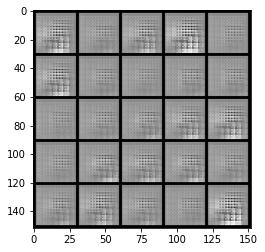

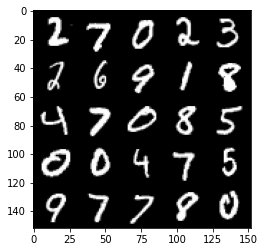

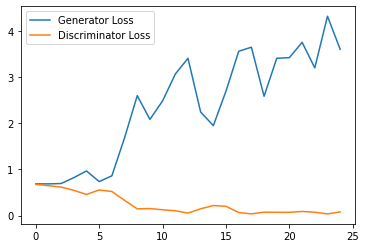

Step 1000: Generator loss: 4.285924695491791, discriminator loss: 0.06234745762124658


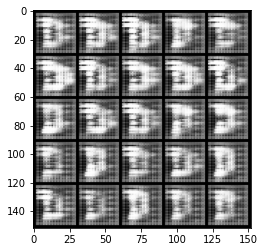

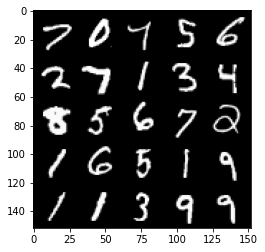

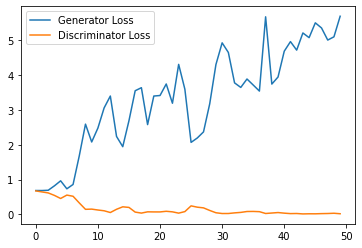

Step 1500: Generator loss: 4.6315960121154784, discriminator loss: 0.06608477897755802


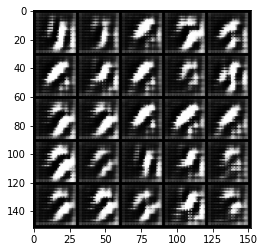

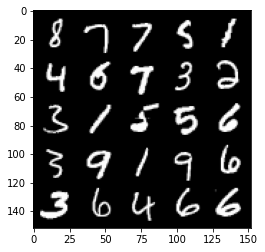

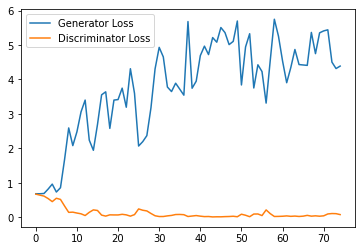

Step 2000: Generator loss: 3.437312658548355, discriminator loss: 0.13413532316312193


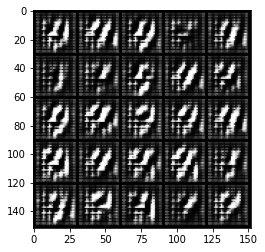

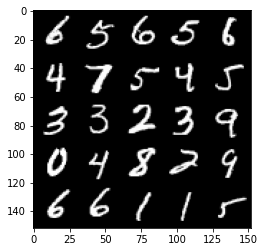

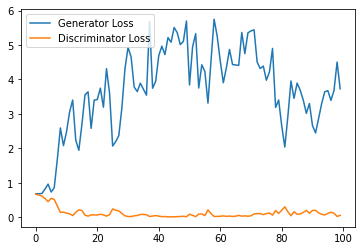

Step 2500: Generator loss: 3.491765911102295, discriminator loss: 0.12604722460731865


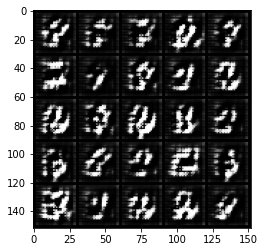

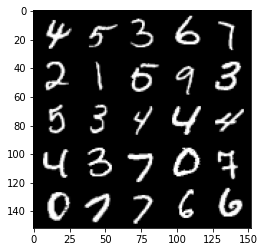

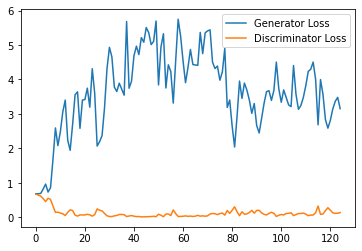

Step 3000: Generator loss: 2.6836019723415374, discriminator loss: 0.2184263694882393


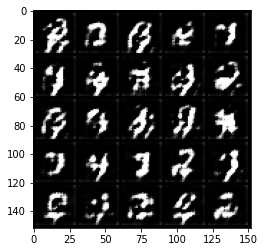

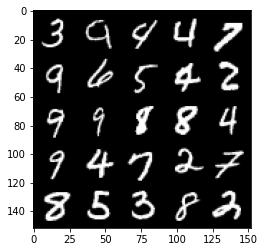

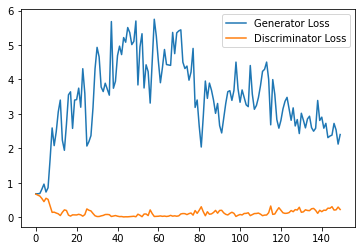

Step 3500: Generator loss: 2.388812509536743, discriminator loss: 0.27837873142957686


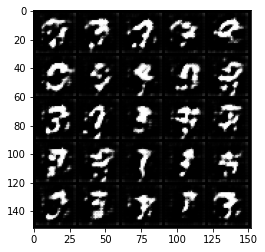

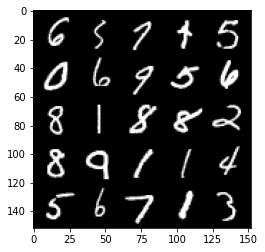

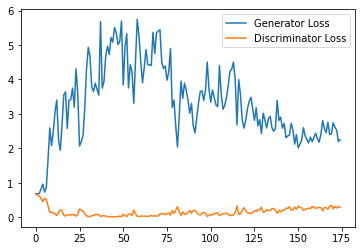

Step 4000: Generator loss: 2.211364723443985, discriminator loss: 0.31234212636947634


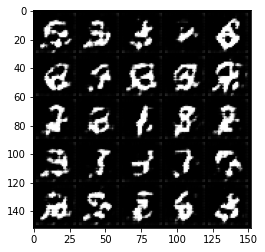

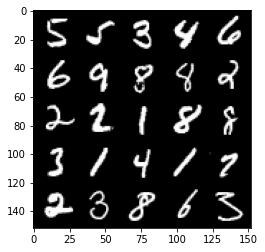

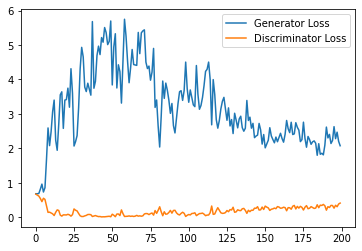

Step 4500: Generator loss: 2.1577220871448515, discriminator loss: 0.2897447115778923


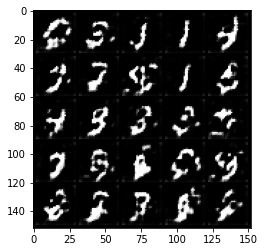

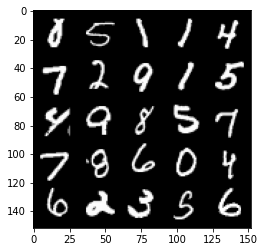

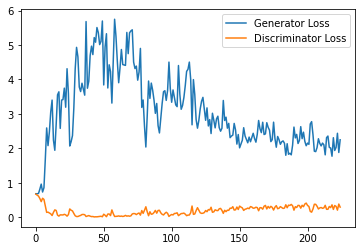

Step 5000: Generator loss: 2.16992972779274, discriminator loss: 0.30397598406672477


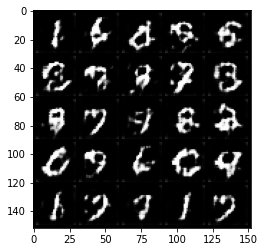

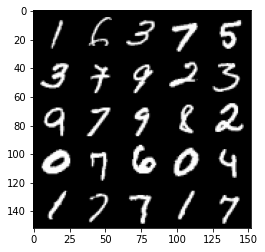

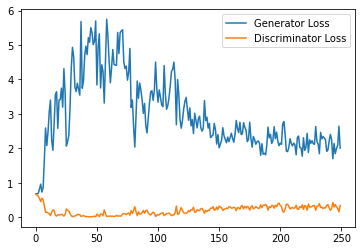

Step 5500: Generator loss: 1.9364243130683898, discriminator loss: 0.3499777893126011


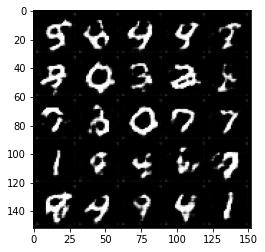

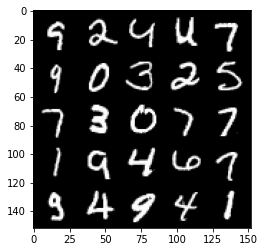

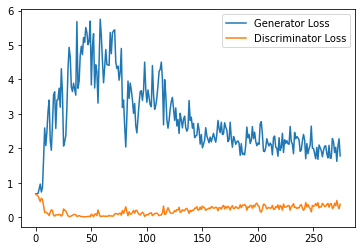

Step 6000: Generator loss: 1.7754343936443329, discriminator loss: 0.3591949070990086


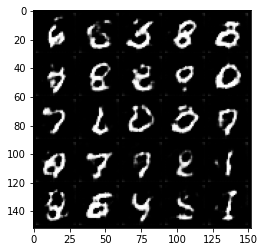

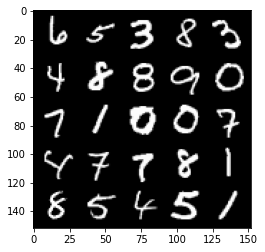

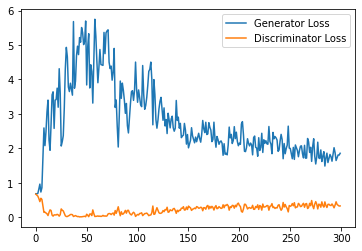

Step 6500: Generator loss: 1.8676963860988618, discriminator loss: 0.37829483884572984


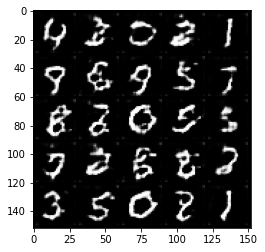

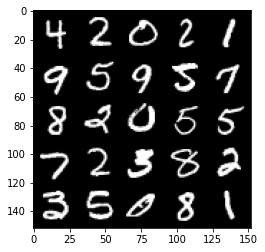

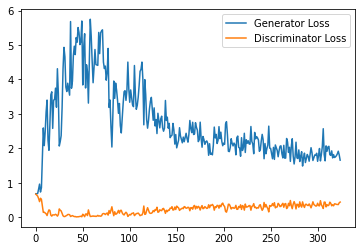

Step 7000: Generator loss: 1.7727530974149703, discriminator loss: 0.39504901272058485


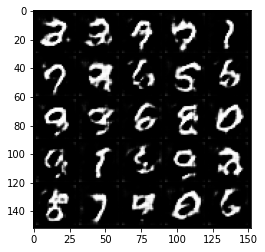

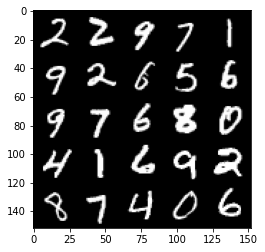

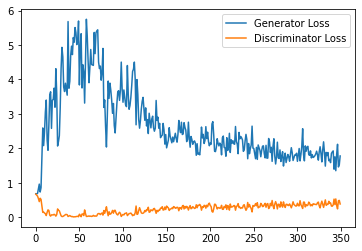

Step 7500: Generator loss: 1.5678587317466737, discriminator loss: 0.4250576122999191


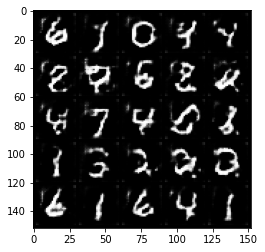

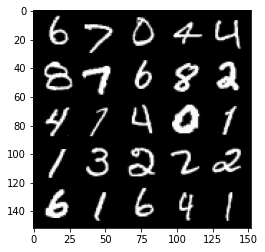

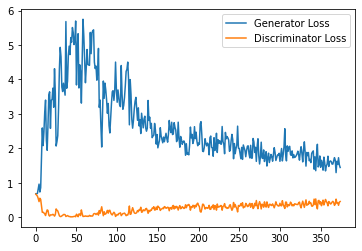

Step 8000: Generator loss: 1.563494415998459, discriminator loss: 0.44807424473762514


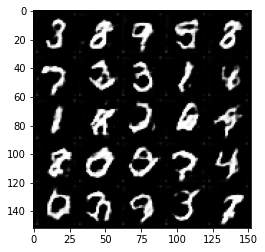

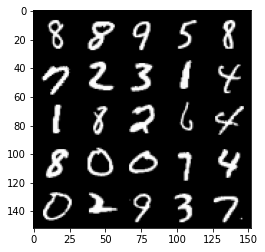

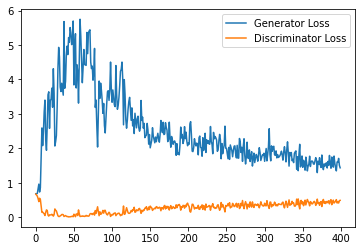

Step 8500: Generator loss: 1.47584965467453, discriminator loss: 0.4787206434309483


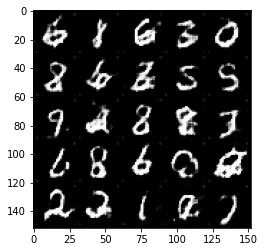

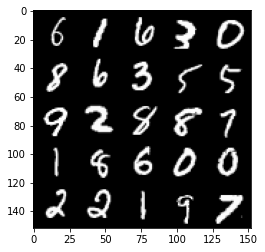

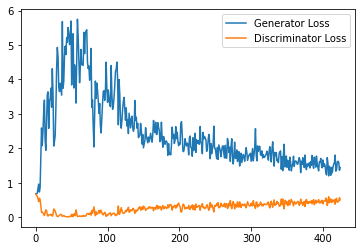

Step 9000: Generator loss: 1.34696431016922, discriminator loss: 0.49522363579273226


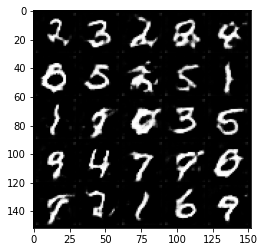

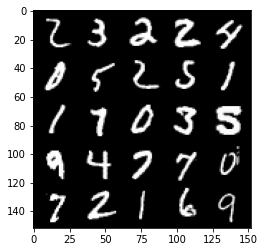

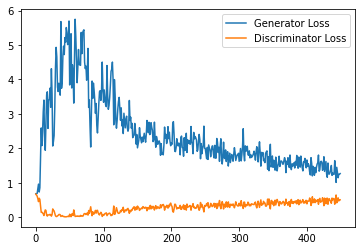

Step 9500: Generator loss: 1.259791495203972, discriminator loss: 0.5271697694063187


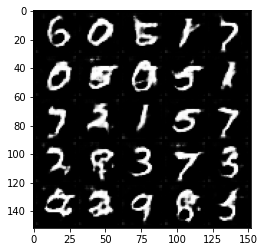

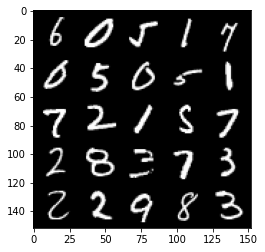

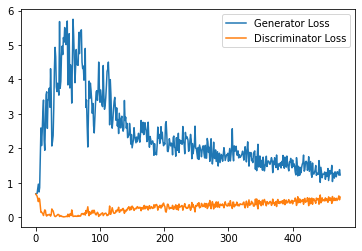

Step 10000: Generator loss: 1.2779596523046493, discriminator loss: 0.5376651651263237


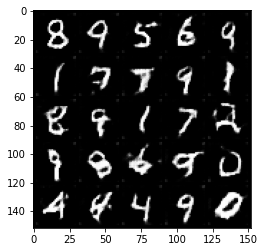

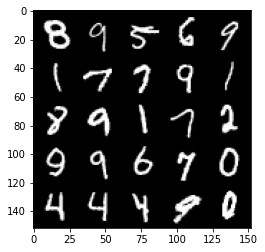

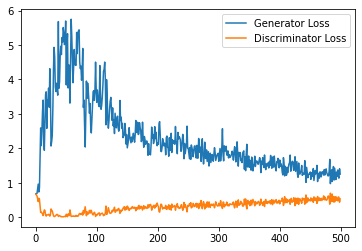

Step 10500: Generator loss: 1.2460481507778167, discriminator loss: 0.5479326741099357


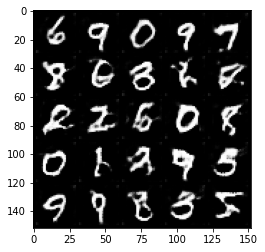

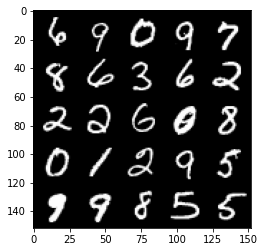

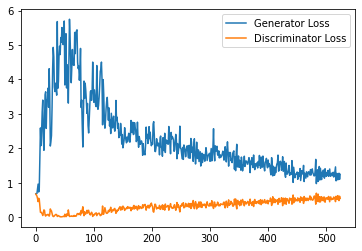

Step 11000: Generator loss: 1.2120903407335282, discriminator loss: 0.5492742526531219


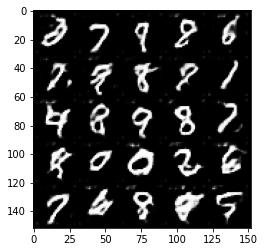

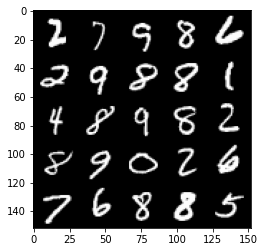

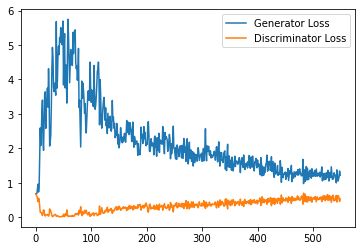

Step 11500: Generator loss: 1.1777915229797364, discriminator loss: 0.5584004025459289


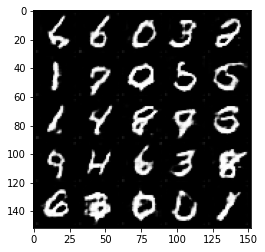

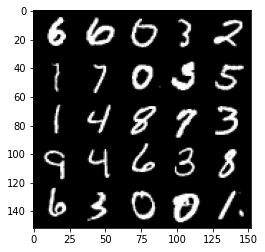

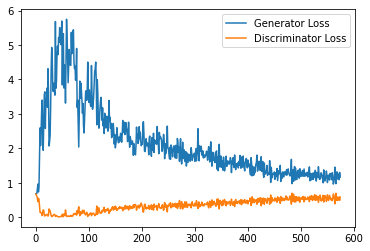

Step 12000: Generator loss: 1.171530809402466, discriminator loss: 0.5592104661464691


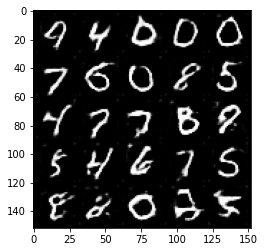

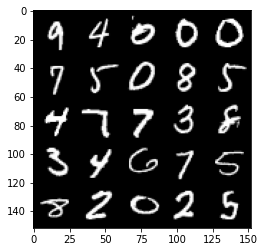

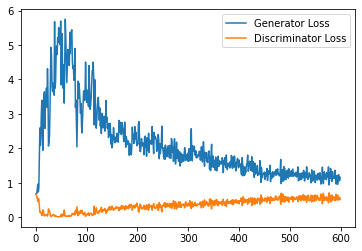

Step 12500: Generator loss: 1.1151039688587188, discriminator loss: 0.5664547469019889


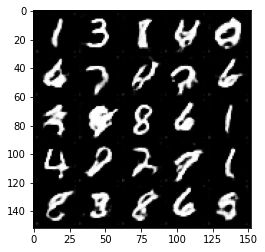

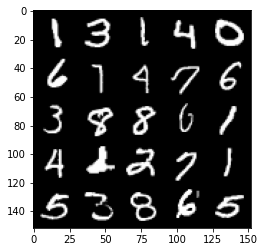

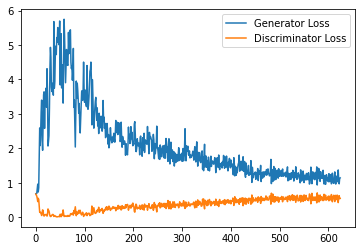

Step 13000: Generator loss: 1.1225996165275574, discriminator loss: 0.5730045770406723


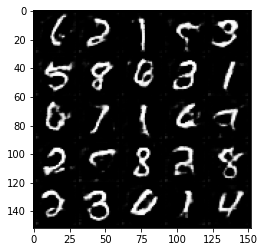

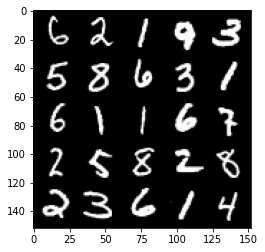

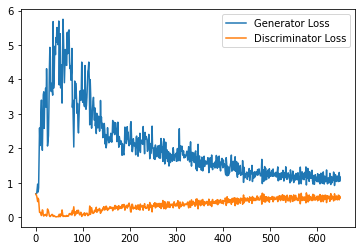

Step 13500: Generator loss: 1.108727382183075, discriminator loss: 0.5783211429715156


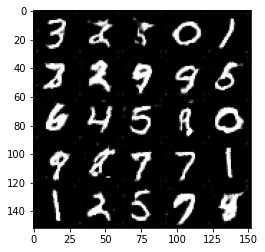

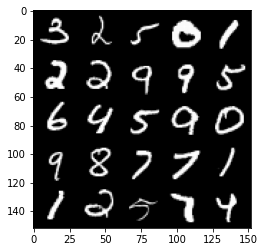

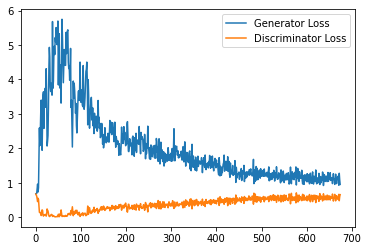

Step 14000: Generator loss: 1.1013245245218277, discriminator loss: 0.5700242061614991


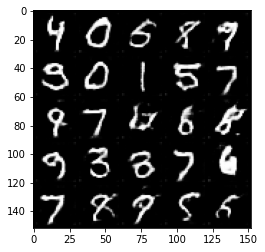

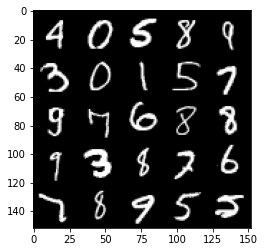

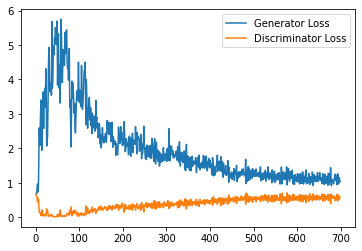

Step 14500: Generator loss: 1.1302371975183487, discriminator loss: 0.5770695075392723


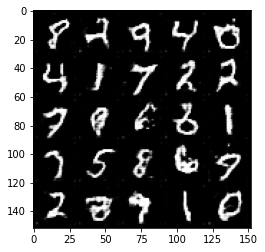

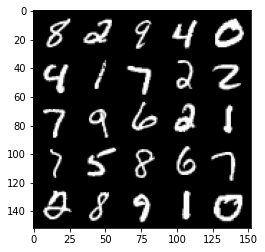

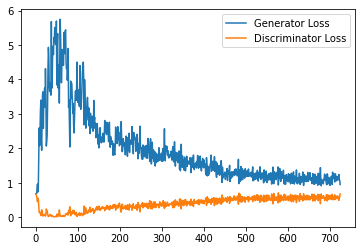

Step 15000: Generator loss: 1.1044992221593857, discriminator loss: 0.5737723836302757


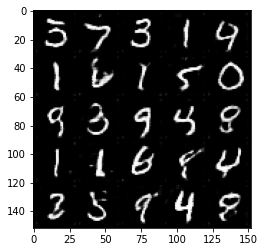

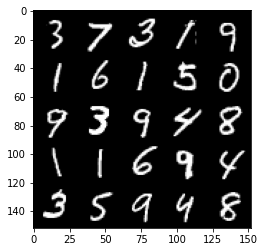

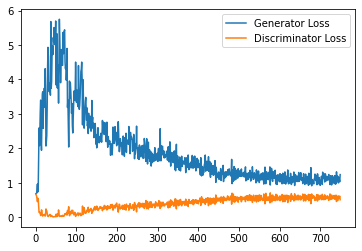

Step 15500: Generator loss: 1.0832243057489395, discriminator loss: 0.5822330932021141


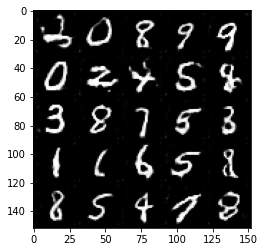

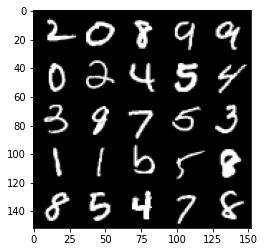

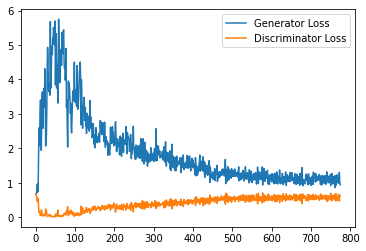

Step 16000: Generator loss: 1.0735777965784072, discriminator loss: 0.5850340319275856


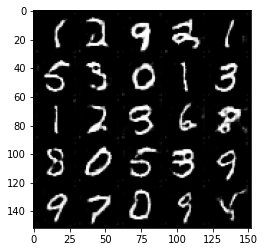

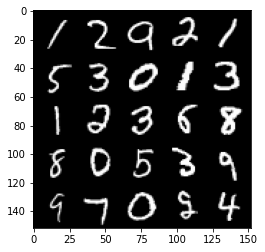

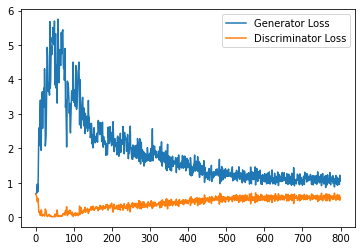

Step 16500: Generator loss: 1.072596306681633, discriminator loss: 0.5856125394105911


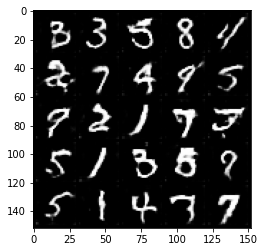

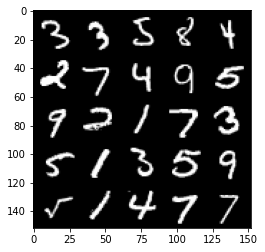

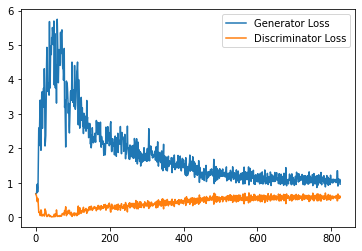

Step 17000: Generator loss: 1.0196358432769776, discriminator loss: 0.5896271002292633


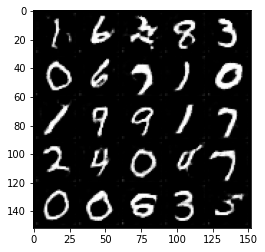

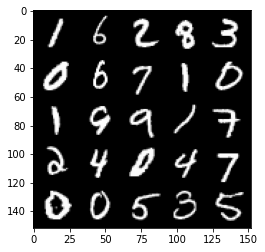

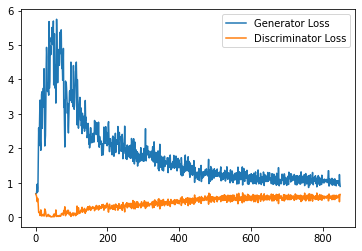

Step 17500: Generator loss: 1.0386593922376632, discriminator loss: 0.583773691534996


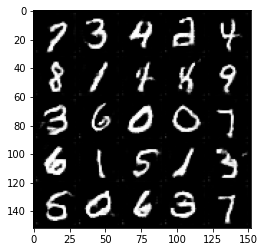

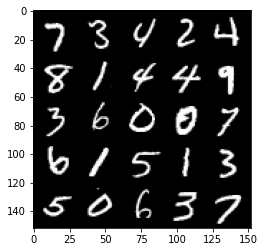

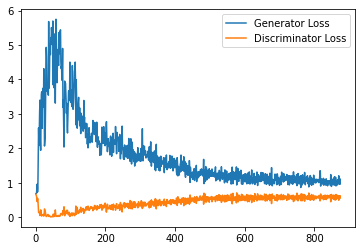

Step 18000: Generator loss: 1.0427282721996307, discriminator loss: 0.5820293707251549


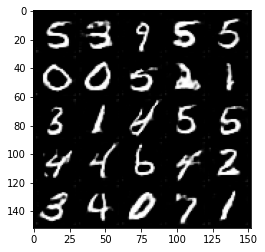

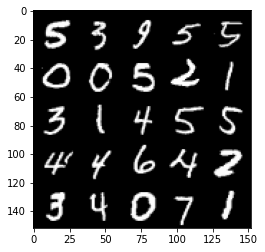

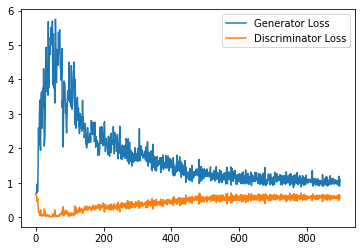

Step 18500: Generator loss: 1.0413805224895478, discriminator loss: 0.5879069214463234


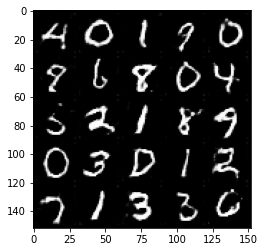

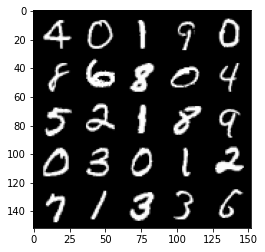

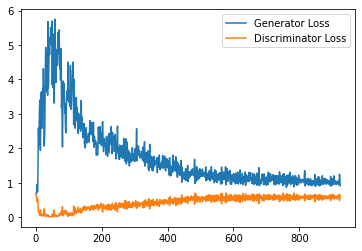

Step 19000: Generator loss: 1.0583877280950547, discriminator loss: 0.5939814178347588


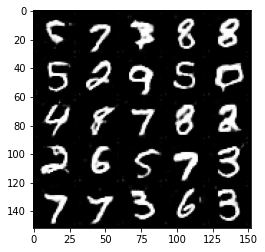

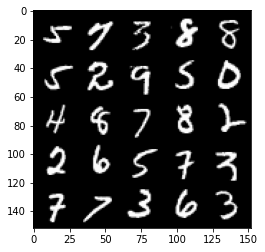

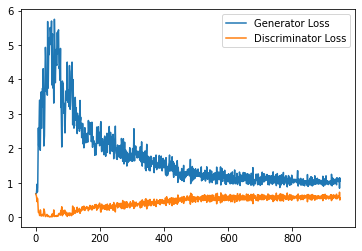

Step 19500: Generator loss: 0.9981172988414765, discriminator loss: 0.5959060696959495


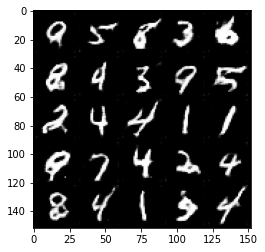

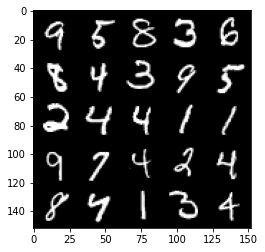

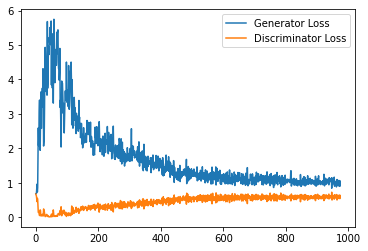

Step 20000: Generator loss: 1.0015433685779571, discriminator loss: 0.5973317221403122


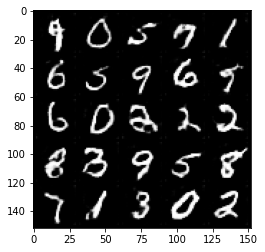

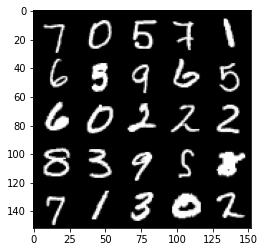

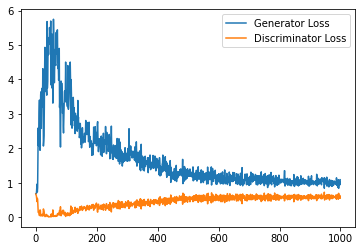

Step 20500: Generator loss: 1.0052800315618515, discriminator loss: 0.6023524316549301


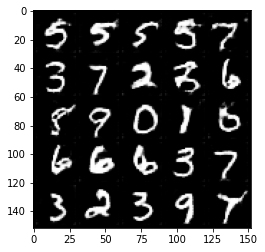

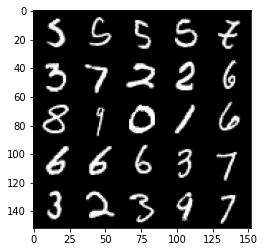

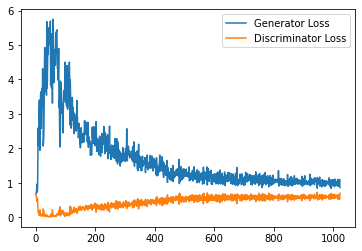

Step 21000: Generator loss: 1.0016907311677932, discriminator loss: 0.5984924953579903


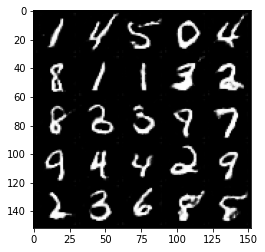

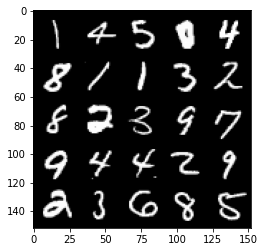

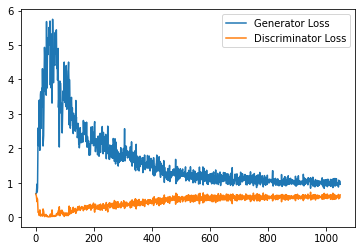

Step 21500: Generator loss: 0.9908578270673751, discriminator loss: 0.5992911977767944


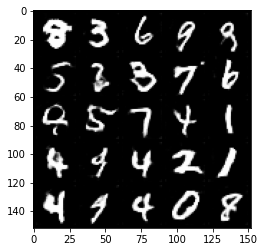

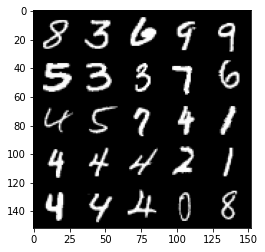

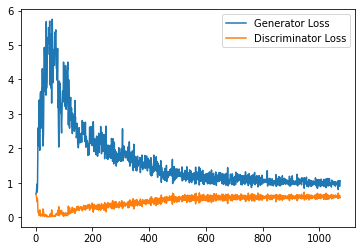

Step 22000: Generator loss: 0.9816381452083588, discriminator loss: 0.6056318544745445


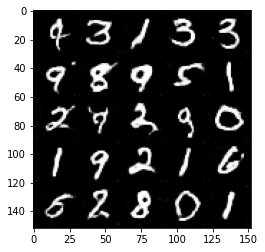

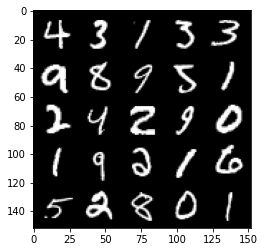

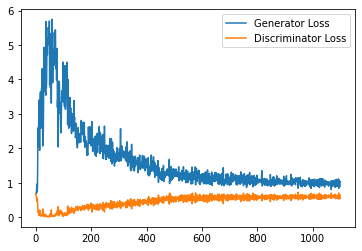

Step 22500: Generator loss: 0.9941909503936768, discriminator loss: 0.6082148258090019


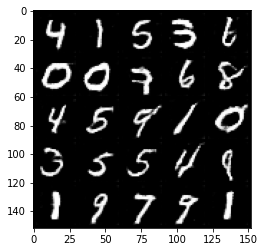

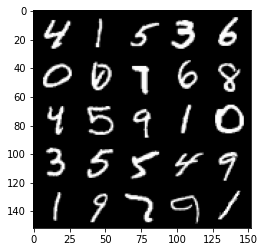

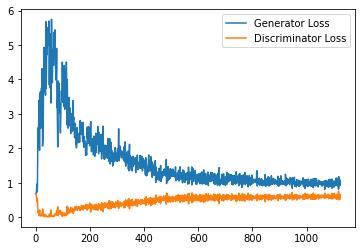

Step 23000: Generator loss: 0.9666291970014572, discriminator loss: 0.6036274317502975


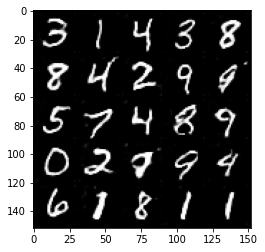

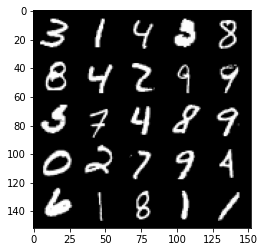

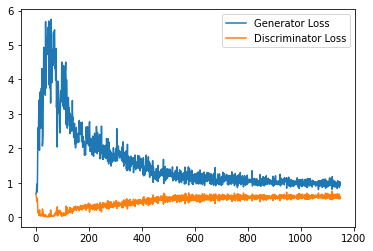

Step 23500: Generator loss: 0.9646050230264663, discriminator loss: 0.6118406699299812


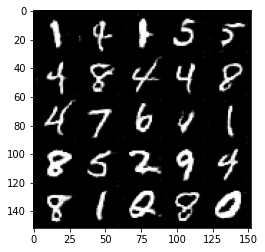

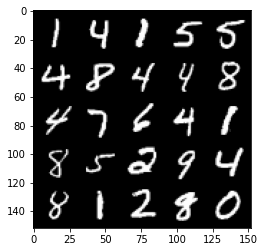

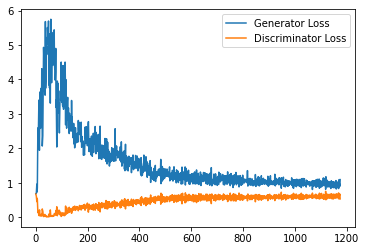

Step 24000: Generator loss: 0.9829218739271164, discriminator loss: 0.6109987662434578


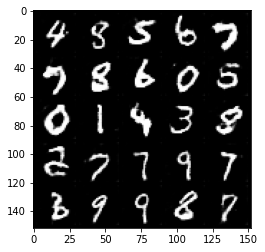

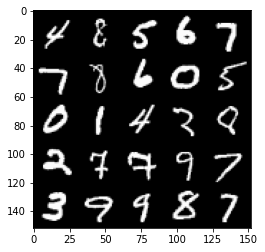

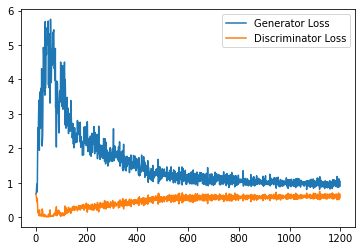

Step 24500: Generator loss: 0.9716545836925506, discriminator loss: 0.6119982872605324


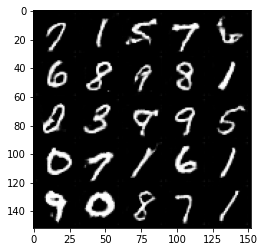

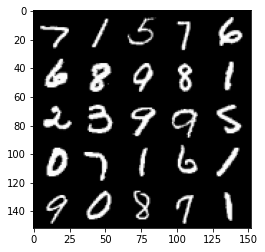

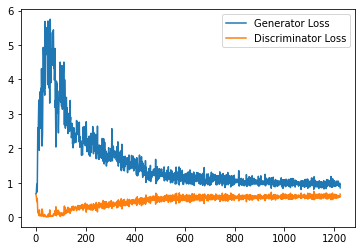

Step 25000: Generator loss: 0.9504999948740005, discriminator loss: 0.6102483189105987


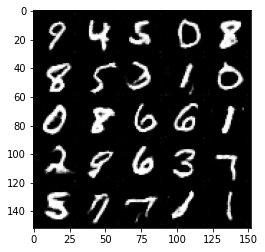

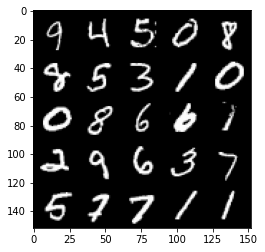

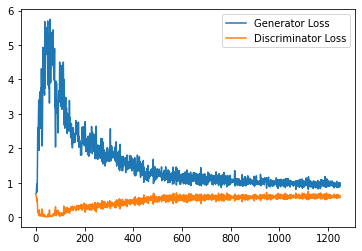

Step 25500: Generator loss: 0.958316970705986, discriminator loss: 0.6141149038076401


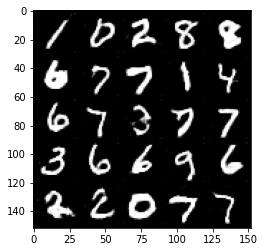

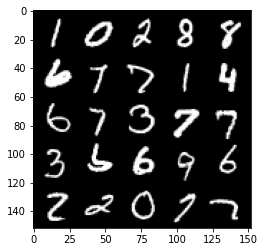

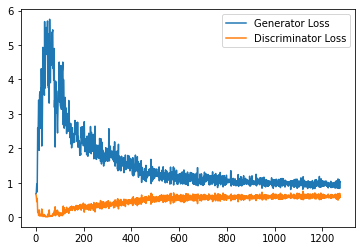

Step 26000: Generator loss: 0.9674536598920822, discriminator loss: 0.6126393187046051


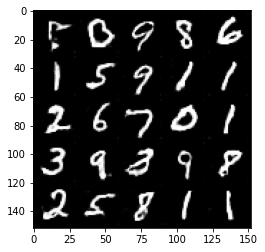

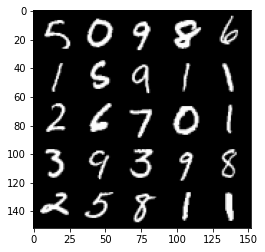

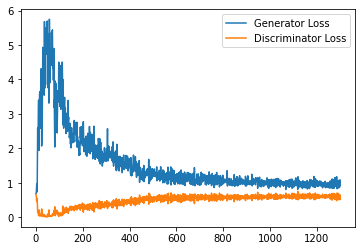

Step 26500: Generator loss: 0.9432015591859817, discriminator loss: 0.620183690071106


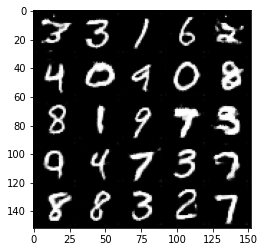

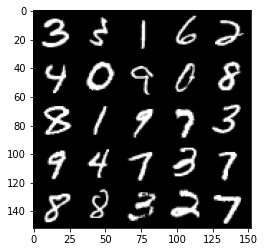

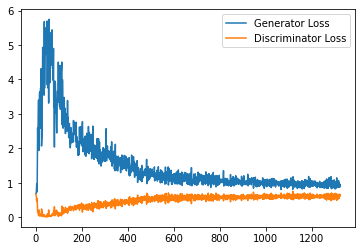

Step 27000: Generator loss: 0.942460234284401, discriminator loss: 0.611560714006424


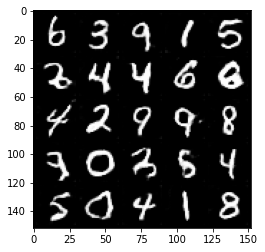

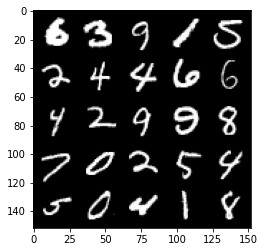

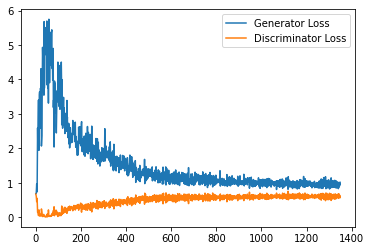

Step 27500: Generator loss: 0.9675048381090164, discriminator loss: 0.617167351782322


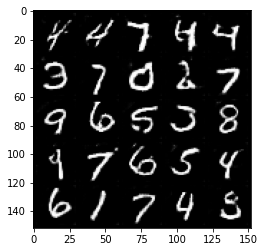

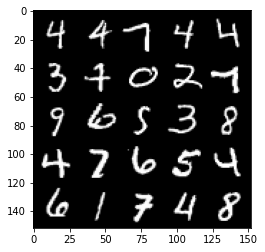

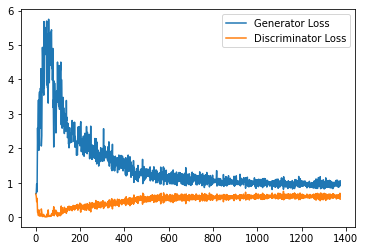

Step 28000: Generator loss: 0.9435386126041412, discriminator loss: 0.6220818403959274


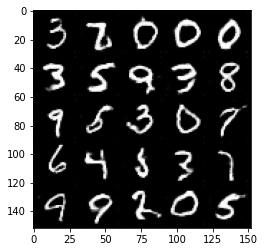

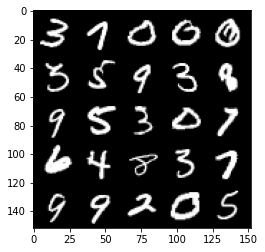

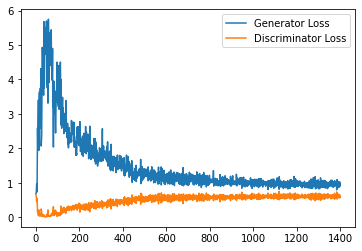

Step 28500: Generator loss: 0.9514710242748261, discriminator loss: 0.6231468930244446


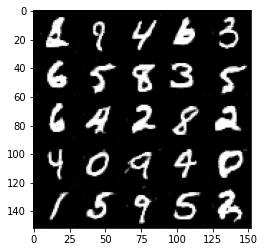

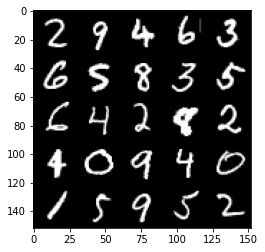

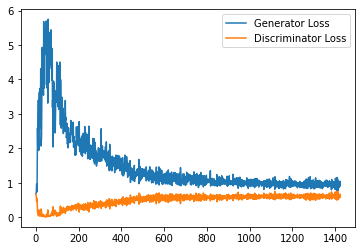

Step 29000: Generator loss: 0.9271711628437043, discriminator loss: 0.6186859965324402


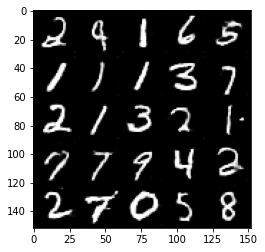

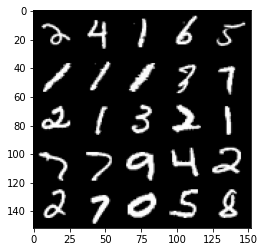

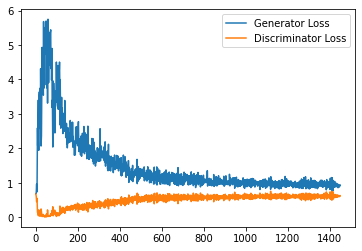

Step 29500: Generator loss: 0.9481277159452438, discriminator loss: 0.6208186309933662


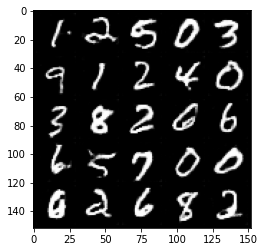

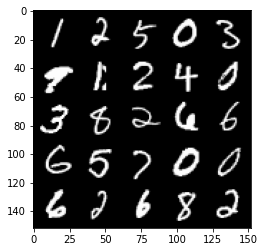

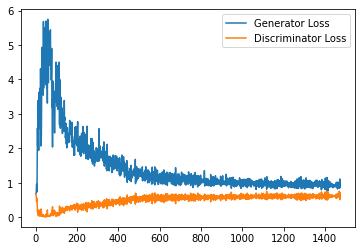

Step 30000: Generator loss: 0.9709255963563919, discriminator loss: 0.621648632466793


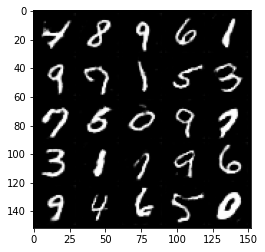

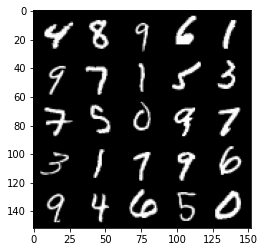

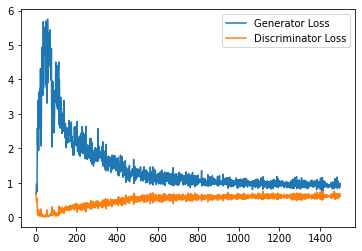

Step 30500: Generator loss: 0.9373566761016846, discriminator loss: 0.6255483393073082


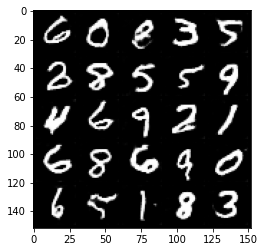

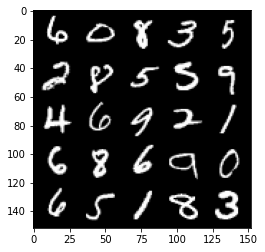

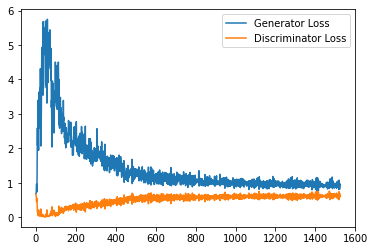

Step 31000: Generator loss: 0.9513508183956146, discriminator loss: 0.6214718700647354


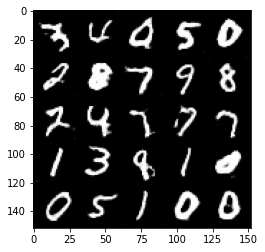

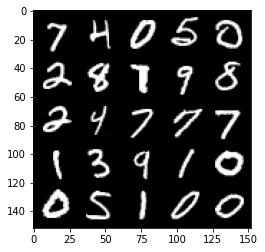

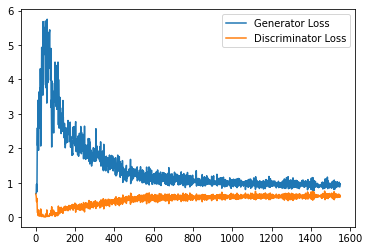

Step 31500: Generator loss: 0.9162956850528717, discriminator loss: 0.6242725154161454


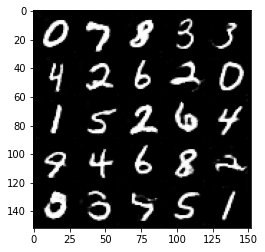

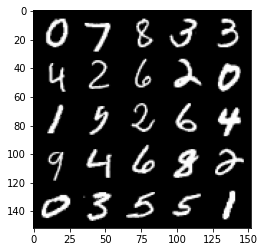

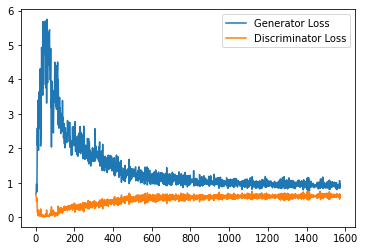

Step 32000: Generator loss: 0.9502024798393249, discriminator loss: 0.6238844344019889


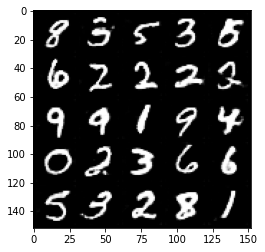

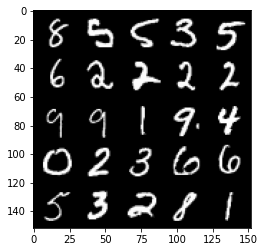

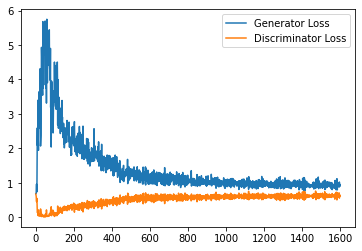

Step 32500: Generator loss: 0.9468134667873382, discriminator loss: 0.6255226802229882


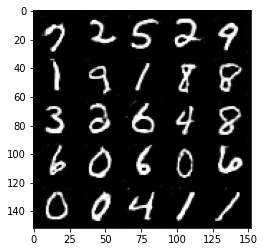

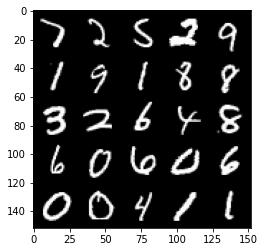

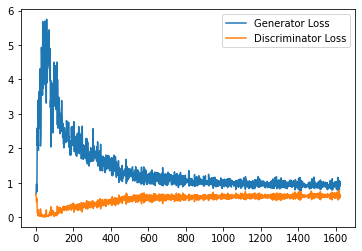

Step 33000: Generator loss: 0.9324853928089142, discriminator loss: 0.6183277683258057


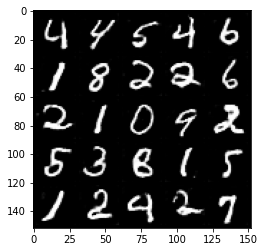

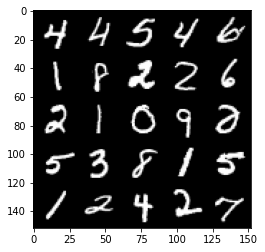

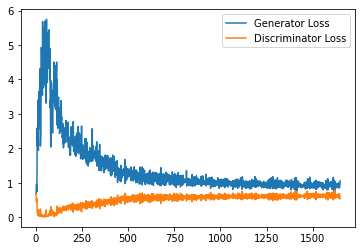

Step 33500: Generator loss: 0.9425434372425079, discriminator loss: 0.6264866461157799


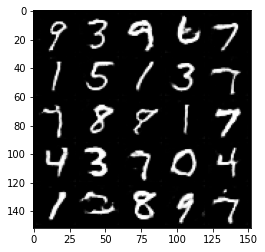

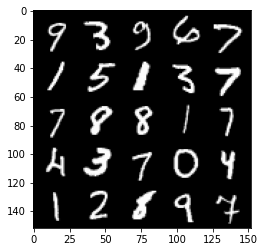

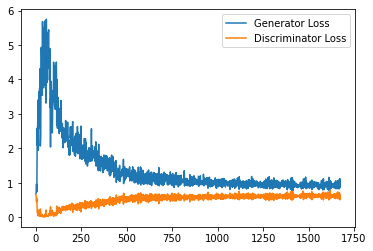

Step 34000: Generator loss: 0.934203898191452, discriminator loss: 0.6185050305128098


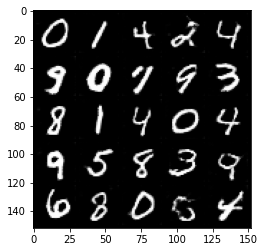

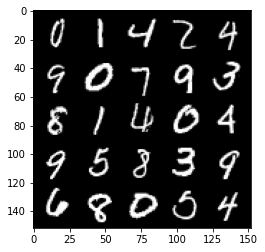

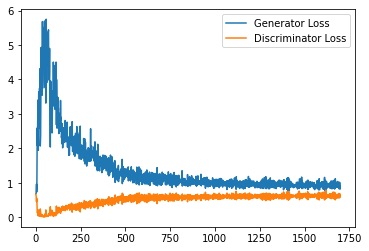

Step 34500: Generator loss: 0.9349012488126754, discriminator loss: 0.6194791361093521


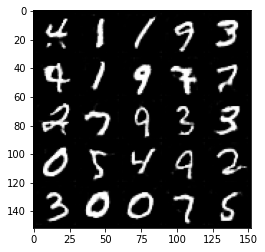

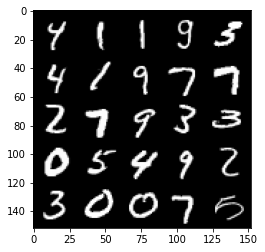

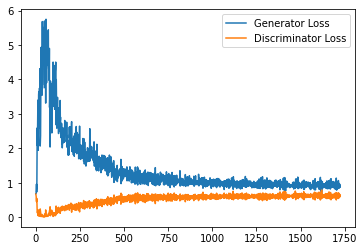

Step 35000: Generator loss: 0.9352170581817627, discriminator loss: 0.6181703151464463


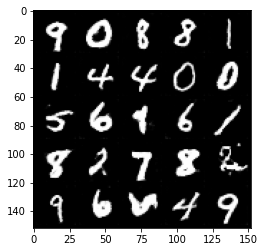

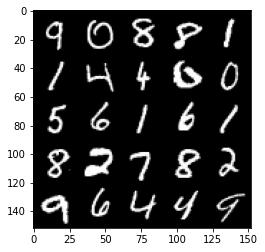

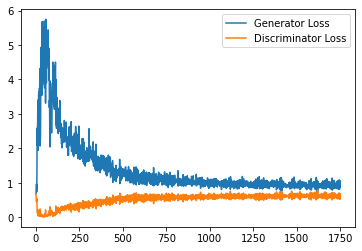

Step 35500: Generator loss: 0.958202663064003, discriminator loss: 0.6263487197160721


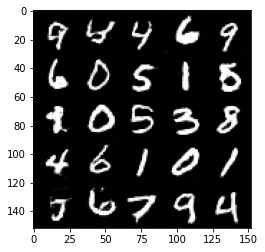

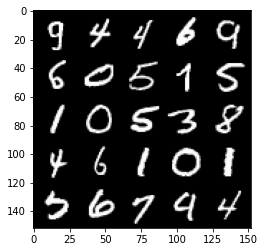

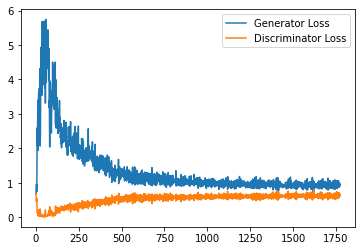

Step 36000: Generator loss: 0.9346971249580384, discriminator loss: 0.6310905055403709


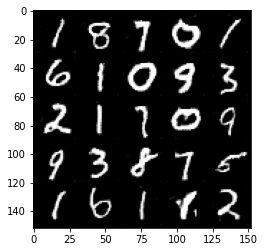

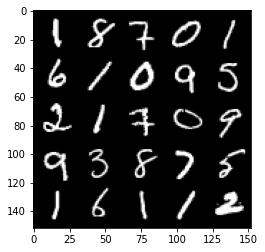

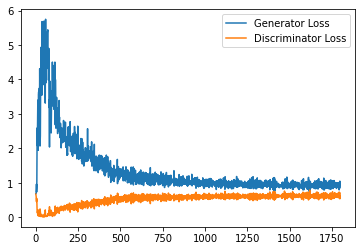

Step 36500: Generator loss: 0.9455136880874634, discriminator loss: 0.6195282702445983


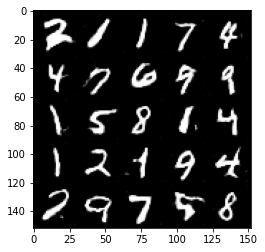

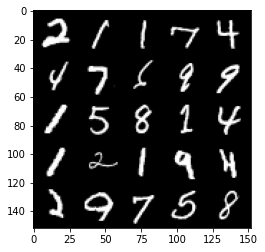

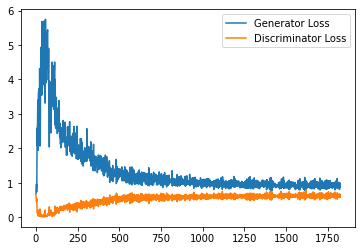

Step 37000: Generator loss: 0.920706729888916, discriminator loss: 0.616045315861702


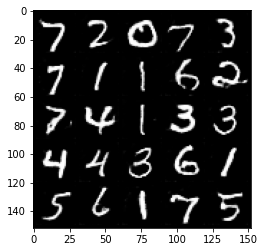

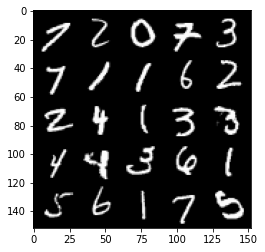

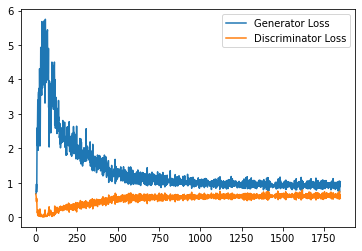

Step 37500: Generator loss: 0.9451157401800155, discriminator loss: 0.6185582545399666


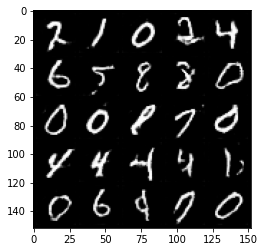

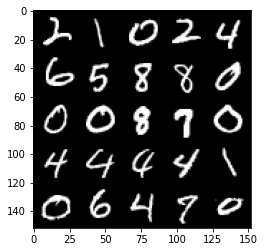

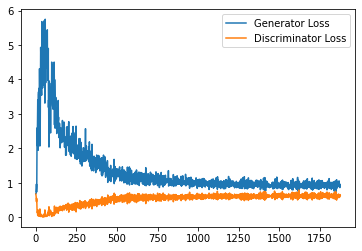

Step 38000: Generator loss: 0.9497656210660934, discriminator loss: 0.62188434278965


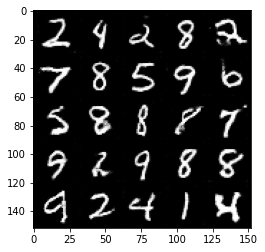

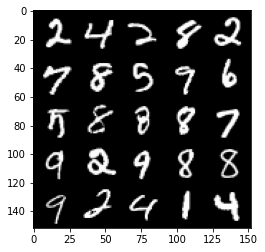

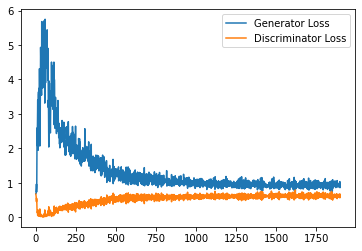

Step 38500: Generator loss: 0.9458877463340759, discriminator loss: 0.617664392888546


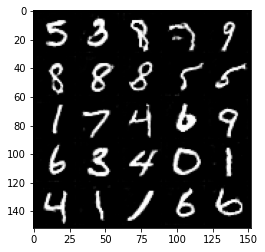

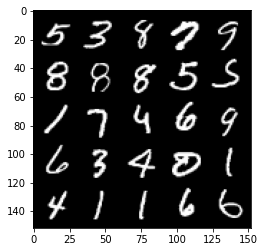

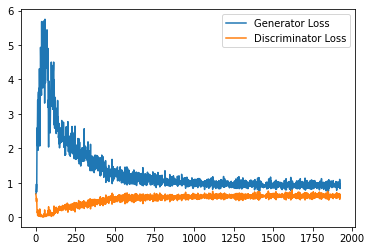

Step 39000: Generator loss: 0.9375054448843002, discriminator loss: 0.6194906191825866


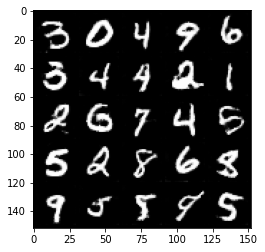

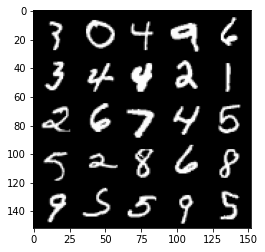

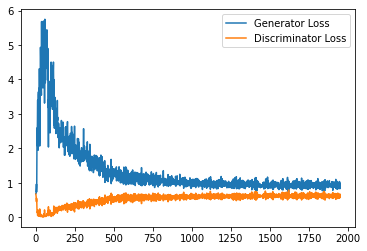

Step 39500: Generator loss: 0.9456904225349426, discriminator loss: 0.6189367085695267


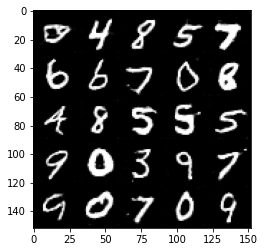

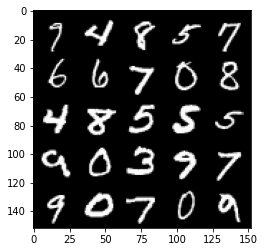

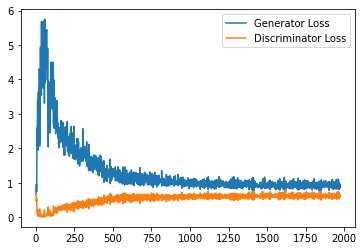

Step 40000: Generator loss: 0.9289495029449463, discriminator loss: 0.6151333255171776


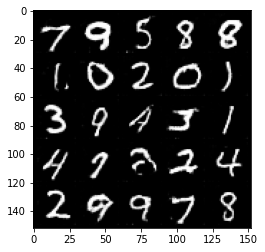

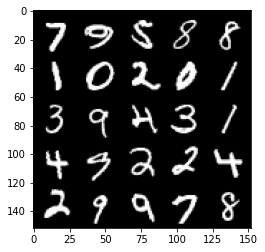

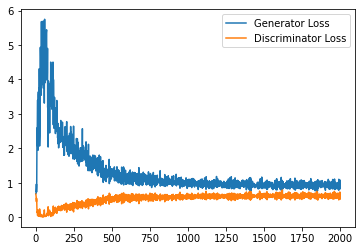

Step 40500: Generator loss: 0.9342794789075851, discriminator loss: 0.6189122347235679


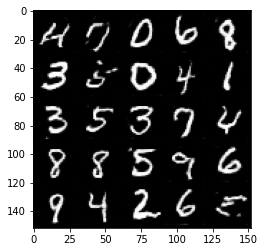

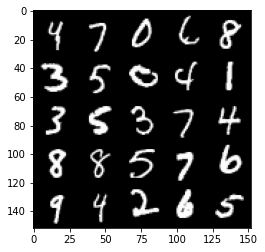

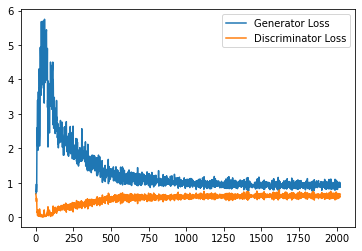

Step 41000: Generator loss: 0.9531653001308441, discriminator loss: 0.6160388919115066


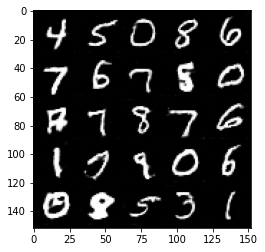

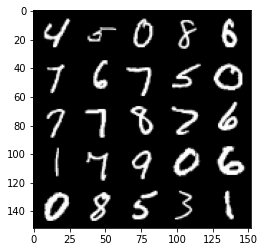

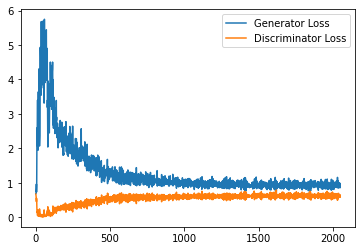

Step 41500: Generator loss: 0.9520341283082963, discriminator loss: 0.6122037799358367


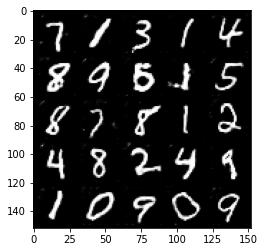

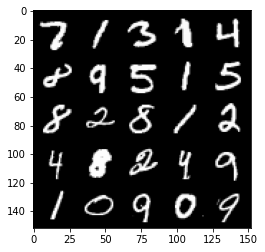

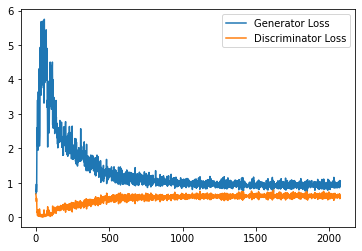

Step 42000: Generator loss: 0.9277231541872024, discriminator loss: 0.6160173391103745


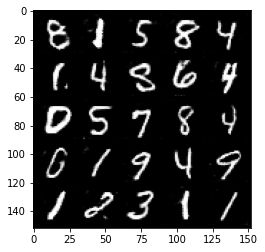

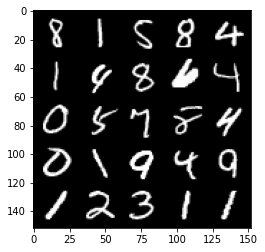

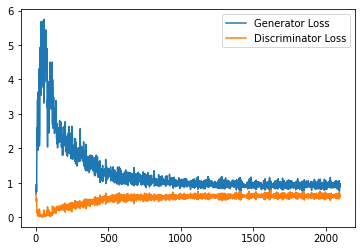

Step 42500: Generator loss: 0.9530265885591507, discriminator loss: 0.6115637807846069


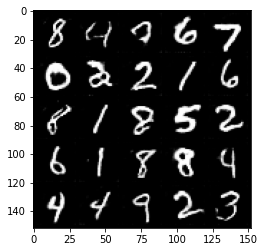

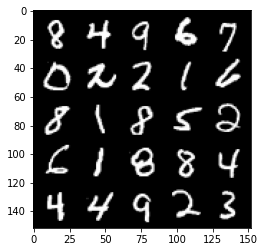

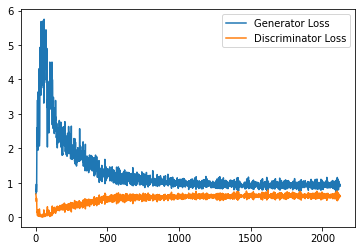

Step 43000: Generator loss: 0.9309724550247193, discriminator loss: 0.6115354369878769


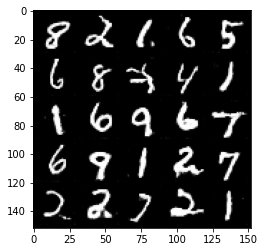

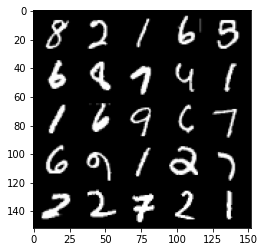

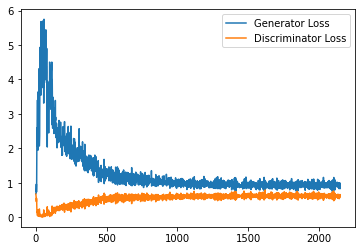

Step 43500: Generator loss: 0.9471014378070831, discriminator loss: 0.6148163232207299


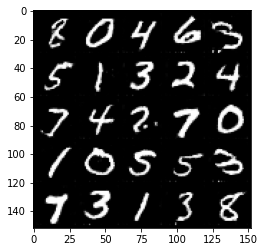

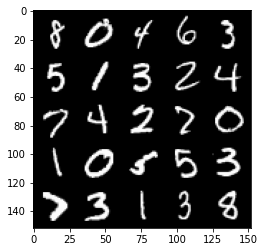

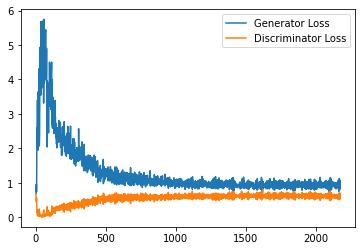

Step 44000: Generator loss: 0.9574589722156525, discriminator loss: 0.6110123145580292


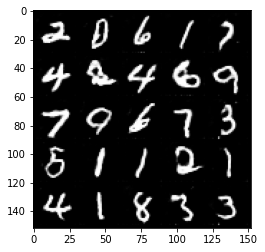

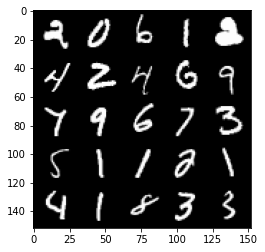

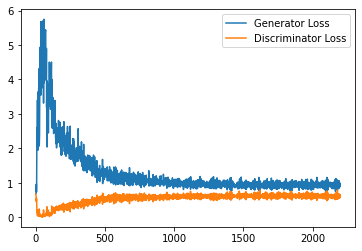

Step 44500: Generator loss: 0.9359437280893326, discriminator loss: 0.6065059902668


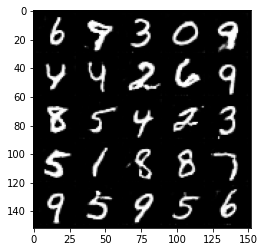

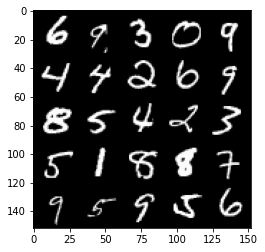

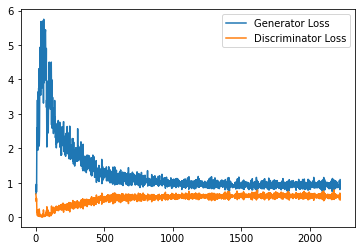

Step 45000: Generator loss: 0.9306176606416702, discriminator loss: 0.6176841385364532


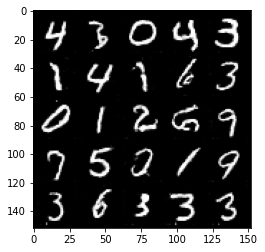

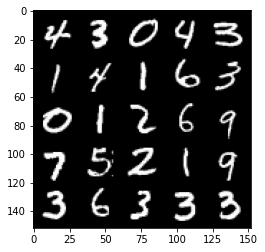

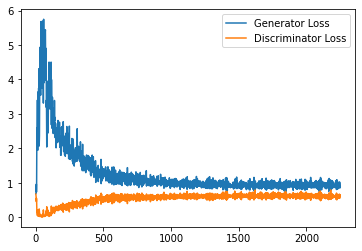

Step 45500: Generator loss: 0.9560094714164734, discriminator loss: 0.6051822179555892


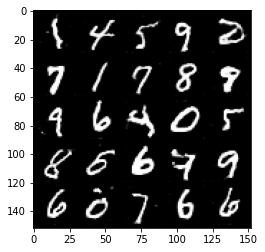

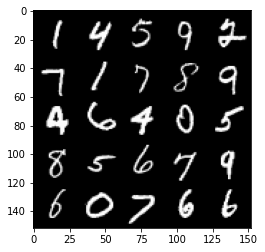

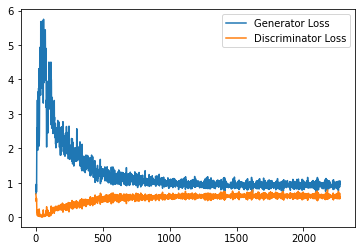

Step 46000: Generator loss: 0.9312920727729798, discriminator loss: 0.619147895038128


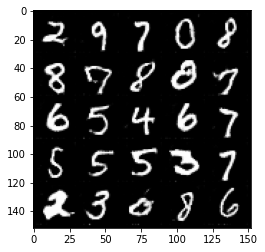

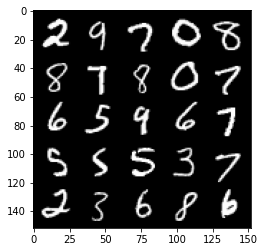

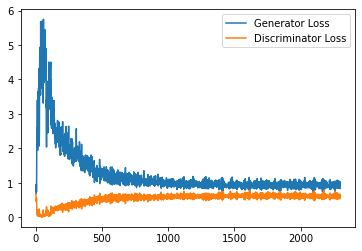

Step 46500: Generator loss: 0.941351171374321, discriminator loss: 0.6058165240287781


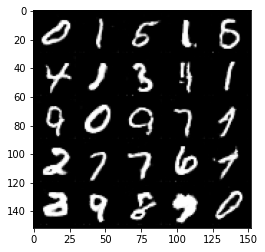

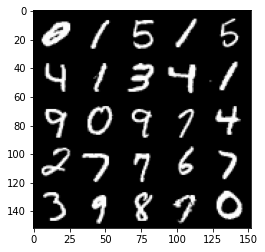

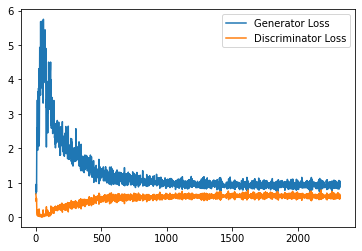

Step 47000: Generator loss: 0.9478709672689438, discriminator loss: 0.6121200765371323


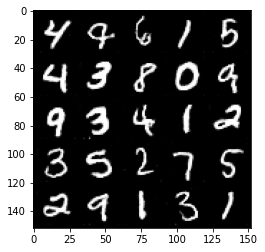

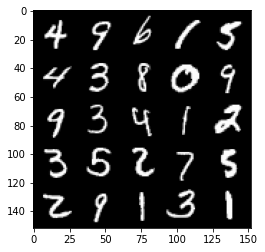

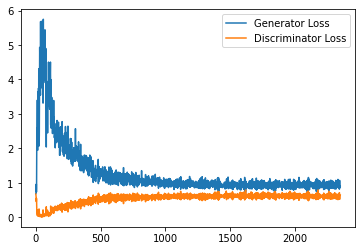

Step 47500: Generator loss: 0.9481876888275147, discriminator loss: 0.6048513097167015


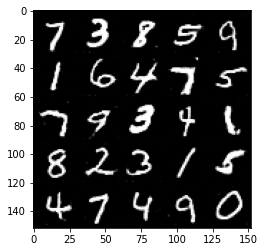

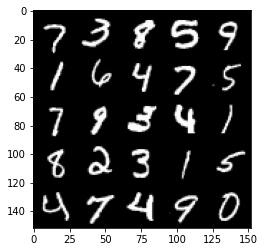

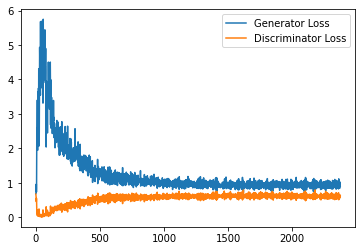

Step 48000: Generator loss: 0.954526565670967, discriminator loss: 0.6033945043087006


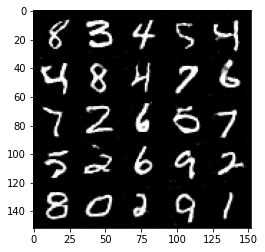

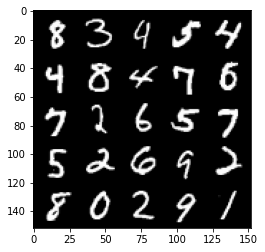

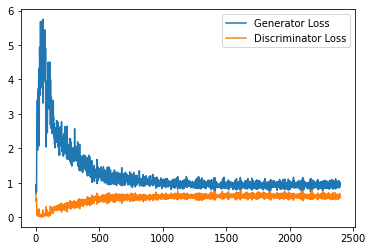

Step 48500: Generator loss: 0.9527733973264694, discriminator loss: 0.6050150863528252


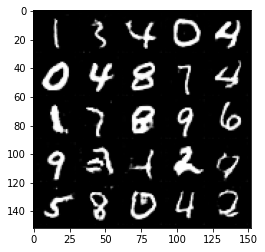

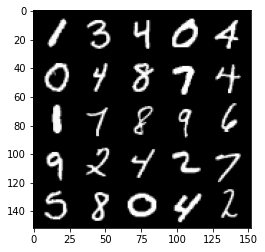

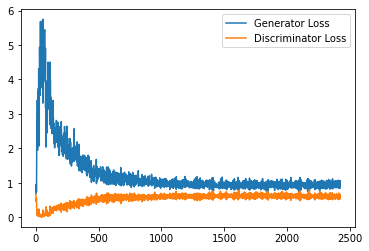

Step 49000: Generator loss: 0.9534855341911316, discriminator loss: 0.6086143069863319


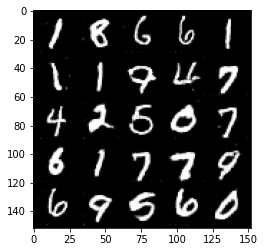

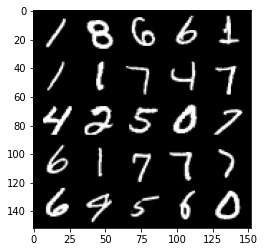

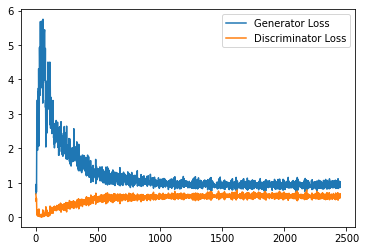

Step 49500: Generator loss: 0.9805768696069718, discriminator loss: 0.5998262754678726


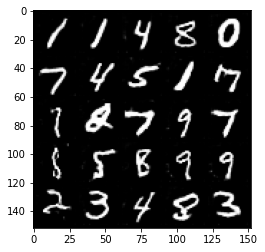

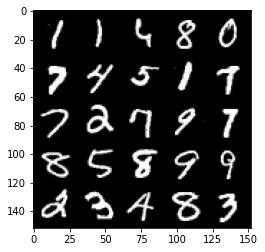

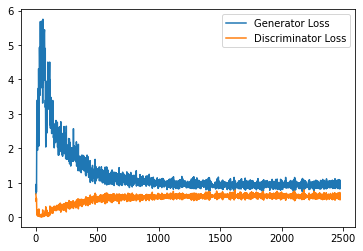

Step 50000: Generator loss: 0.9503067396879196, discriminator loss: 0.6072476835846901


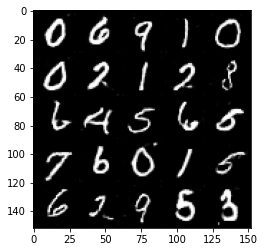

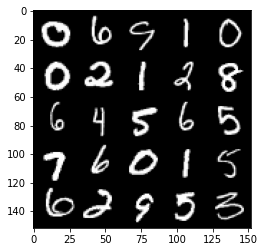

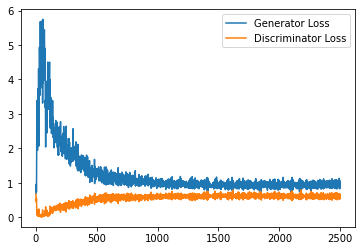

Step 50500: Generator loss: 0.958453439116478, discriminator loss: 0.6022789303660393


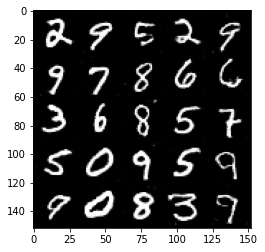

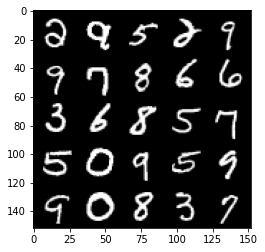

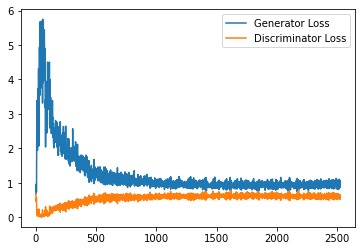

Step 51000: Generator loss: 0.9434306181669235, discriminator loss: 0.60491646784544


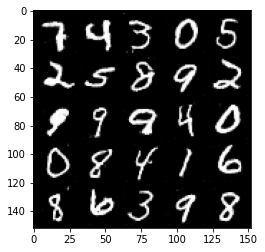

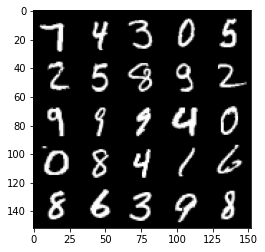

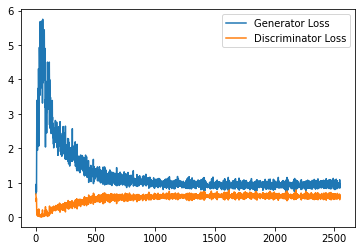

Step 51500: Generator loss: 0.9625130844116211, discriminator loss: 0.6065900910496712


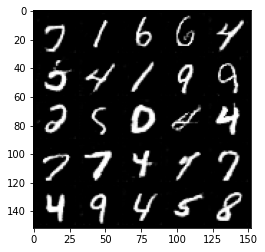

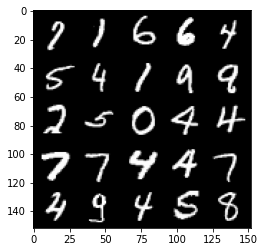

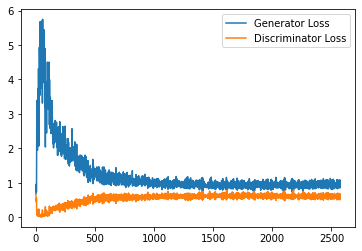

Step 52000: Generator loss: 0.9918215407133102, discriminator loss: 0.6007846281528473


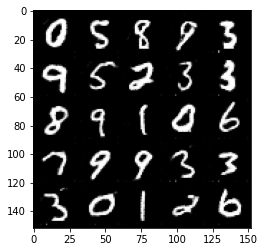

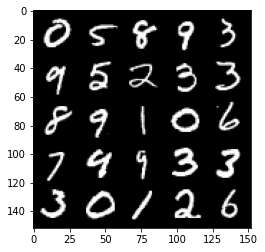

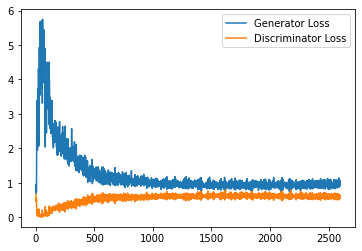

Step 52500: Generator loss: 0.9631207761764526, discriminator loss: 0.603132290482521


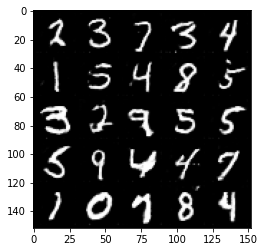

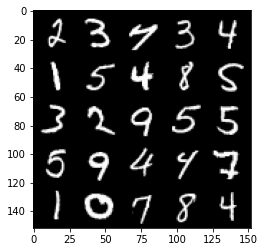

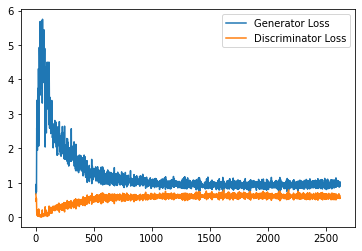

Step 53000: Generator loss: 0.9535310958623886, discriminator loss: 0.6071897205114365


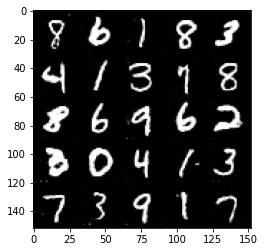

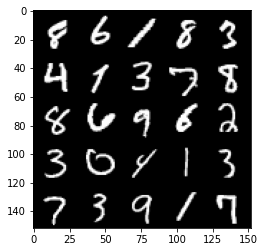

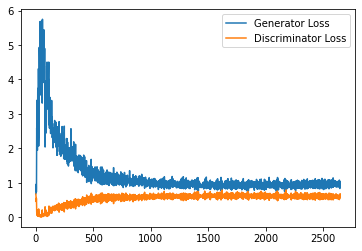

Step 53500: Generator loss: 0.9611491832733154, discriminator loss: 0.6042714396715164


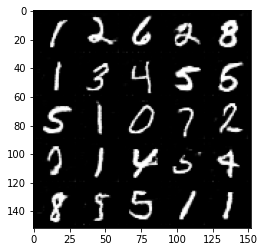

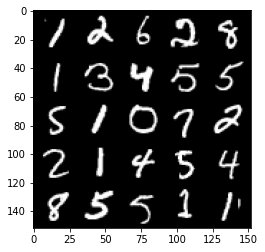

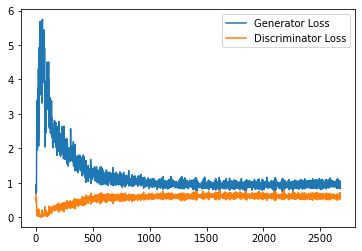

Step 54000: Generator loss: 0.962231164097786, discriminator loss: 0.6049207740426064


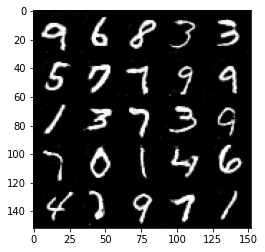

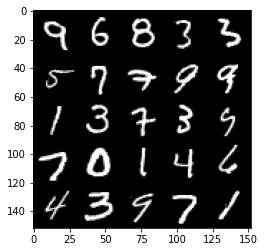

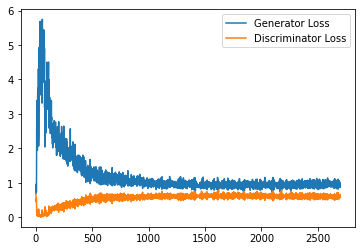

Step 54500: Generator loss: 0.9638562161922455, discriminator loss: 0.6003816830515861


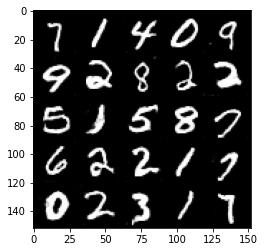

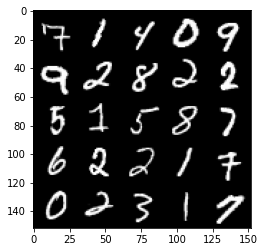

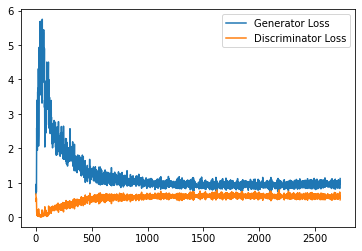

Step 55000: Generator loss: 0.9596225208044052, discriminator loss: 0.6036344150304794


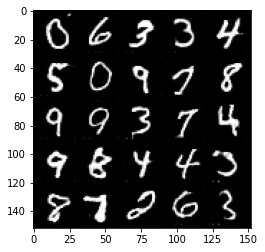

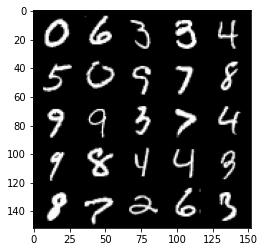

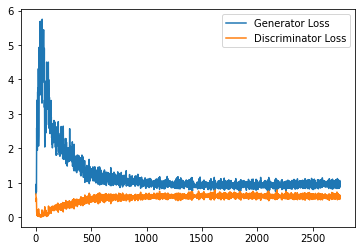

Step 55500: Generator loss: 0.9749019289016724, discriminator loss: 0.5980342410802841


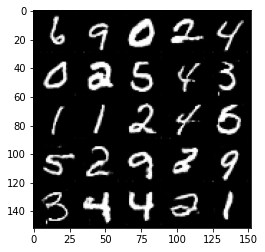

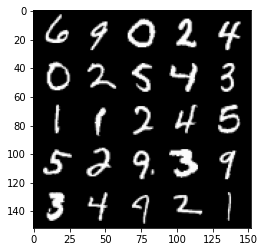

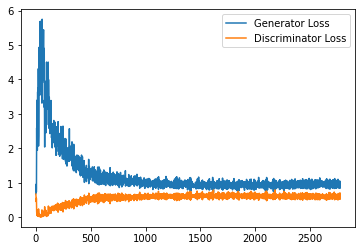

Step 56000: Generator loss: 0.9520466060638427, discriminator loss: 0.5969769108295441


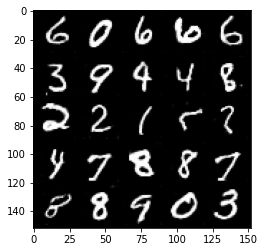

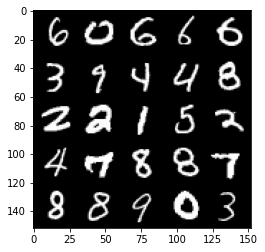

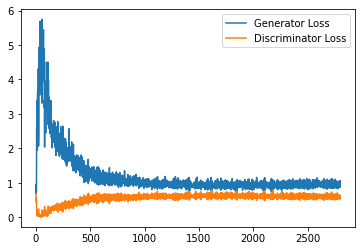

Step 56500: Generator loss: 0.9716222809553147, discriminator loss: 0.5989961255788803


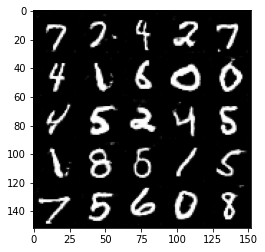

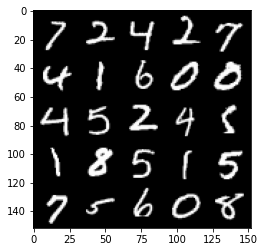

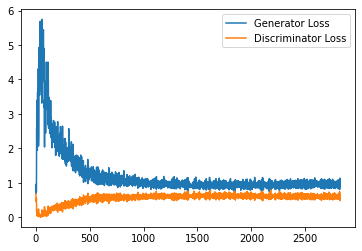

Step 57000: Generator loss: 0.9835035665035248, discriminator loss: 0.5972742249369621


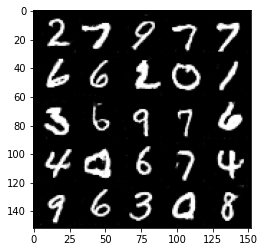

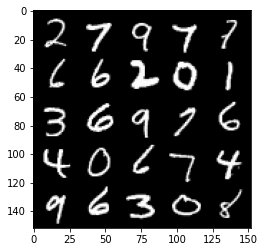

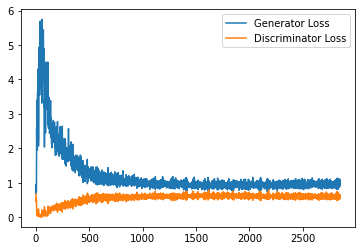

Step 57500: Generator loss: 0.9857091072797776, discriminator loss: 0.5993137243390083


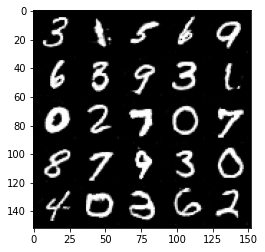

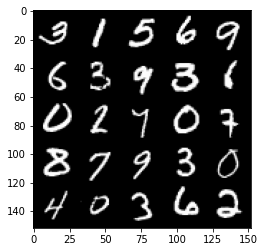

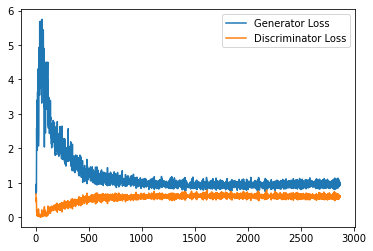

Step 58000: Generator loss: 0.9711622694730758, discriminator loss: 0.6015894609093666


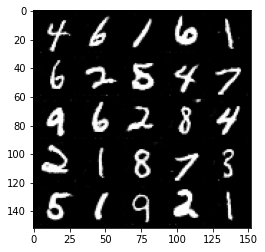

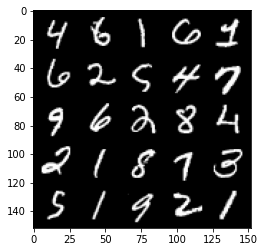

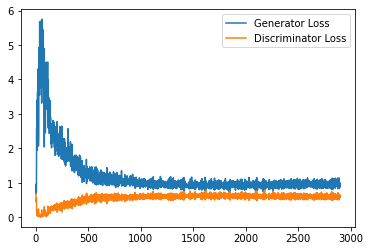

Step 58500: Generator loss: 0.9842759096622467, discriminator loss: 0.5983072128295899


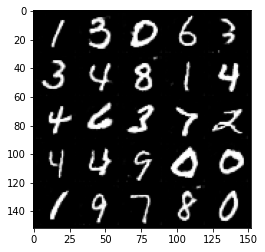

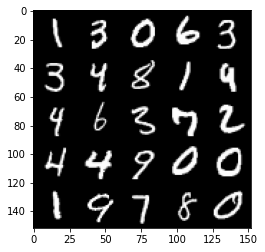

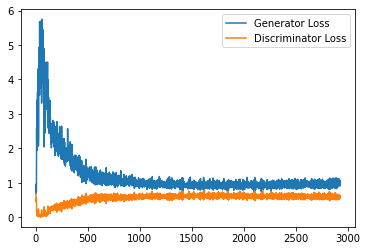

Step 59000: Generator loss: 0.9629098592996598, discriminator loss: 0.6006432558298112


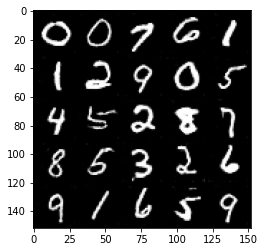

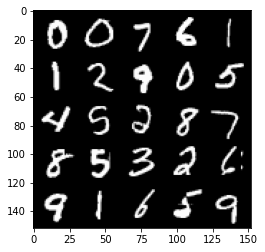

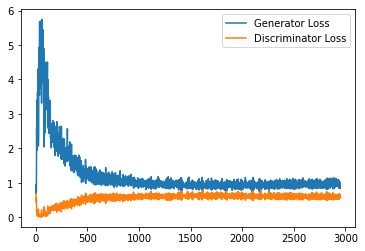

Step 59500: Generator loss: 0.9875554835796356, discriminator loss: 0.5984653049111366


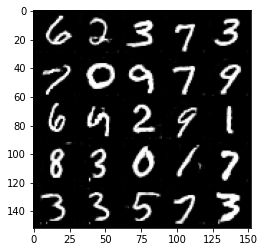

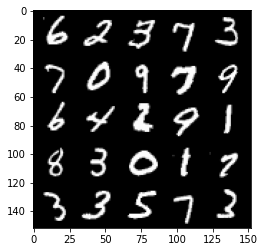

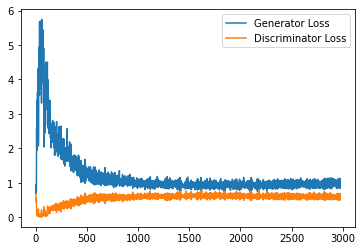

Step 60000: Generator loss: 0.982360916852951, discriminator loss: 0.5992963964343071


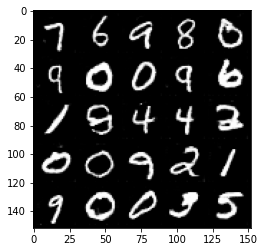

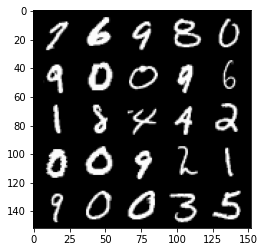

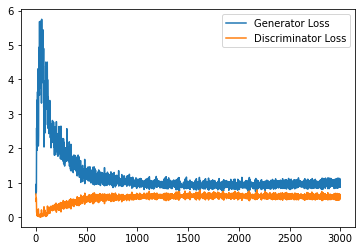

Step 60500: Generator loss: 0.9887553552985191, discriminator loss: 0.6025117987394333


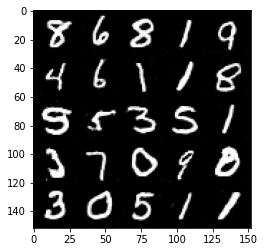

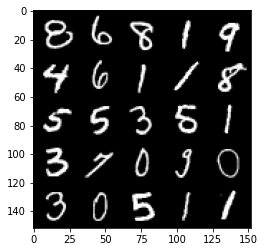

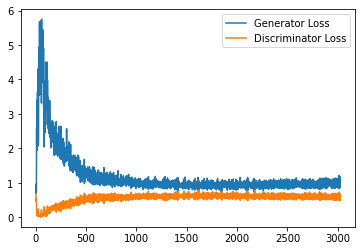

Step 61000: Generator loss: 0.9576904243230819, discriminator loss: 0.6033173655867576


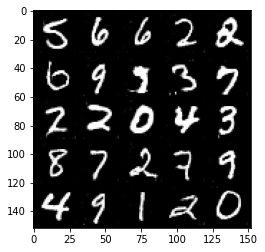

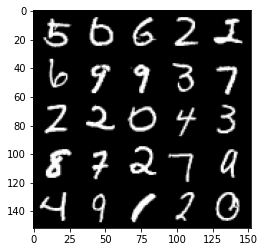

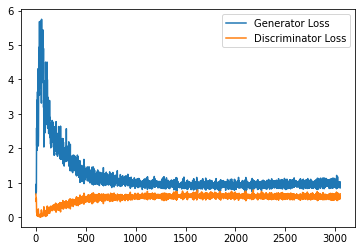

Step 61500: Generator loss: 0.9730938847064972, discriminator loss: 0.5932412520051003


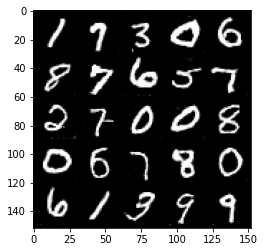

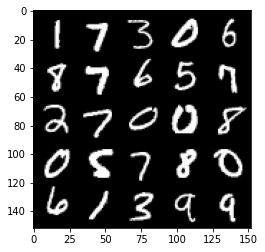

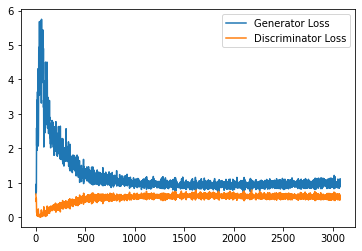

Step 62000: Generator loss: 0.9804879800081253, discriminator loss: 0.6005620018839836


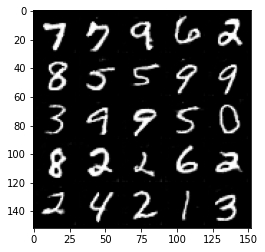

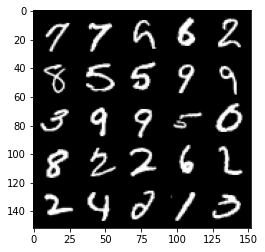

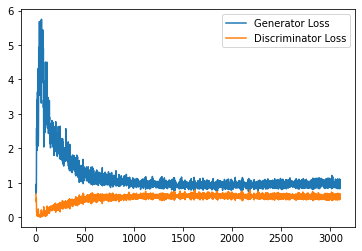

Step 62500: Generator loss: 0.9816851921081543, discriminator loss: 0.5988770074248314


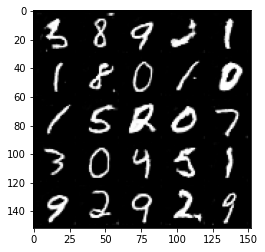

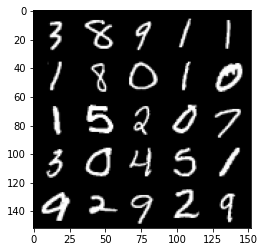

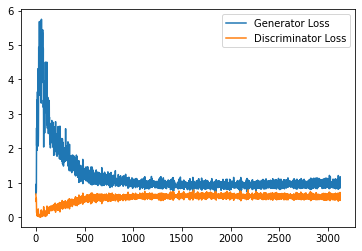

Step 63000: Generator loss: 0.9698776384592056, discriminator loss: 0.6026445738673211


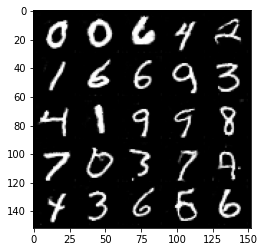

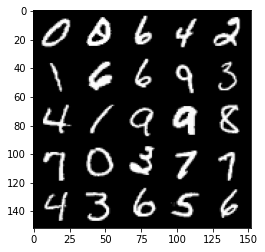

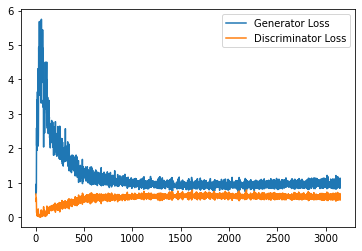

Step 63500: Generator loss: 0.9690698249340057, discriminator loss: 0.601450978577137


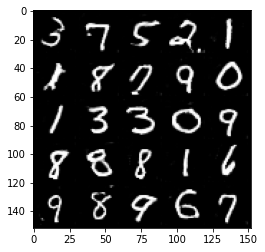

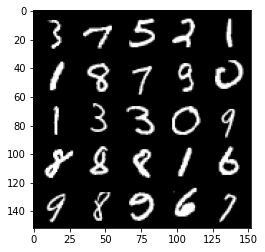

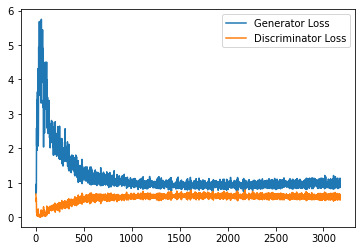

Step 64000: Generator loss: 0.9788706625699997, discriminator loss: 0.5991686264276505


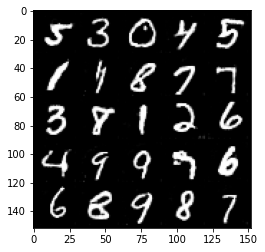

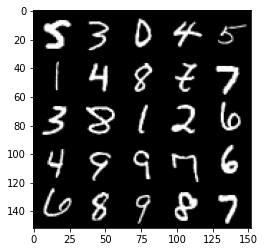

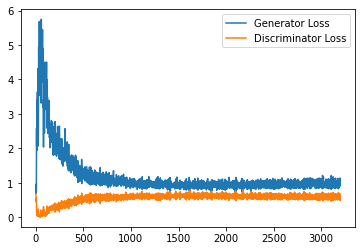

Step 64500: Generator loss: 0.9657373553514481, discriminator loss: 0.6067974526882172


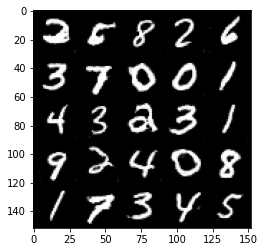

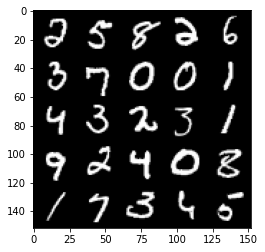

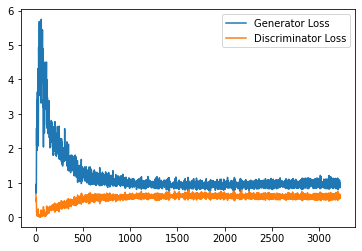

Step 65000: Generator loss: 0.9744662137031556, discriminator loss: 0.5982502279877663


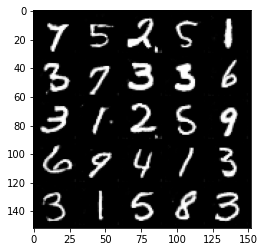

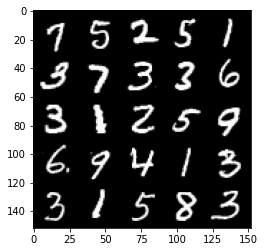

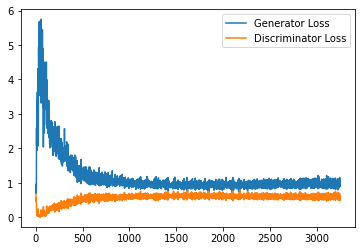

Step 65500: Generator loss: 0.9759066274166107, discriminator loss: 0.6053194725513458


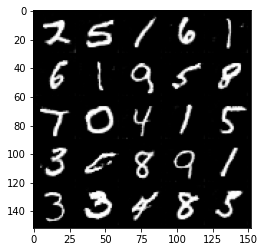

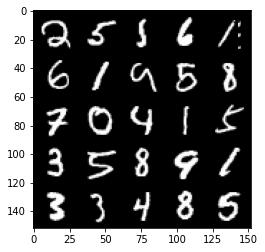

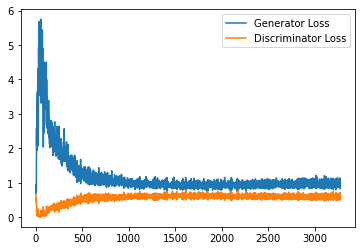

Step 66000: Generator loss: 0.9880289844274521, discriminator loss: 0.5979795469641686


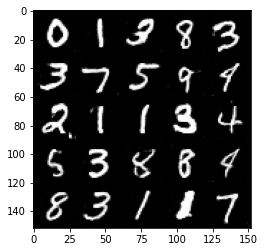

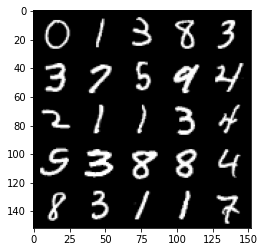

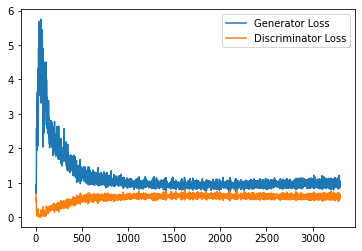

Step 66500: Generator loss: 0.9635183353424073, discriminator loss: 0.6033065994381904


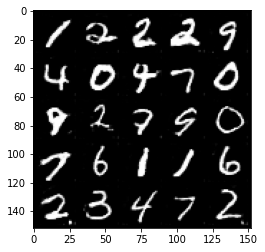

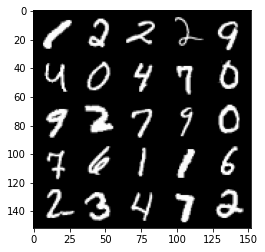

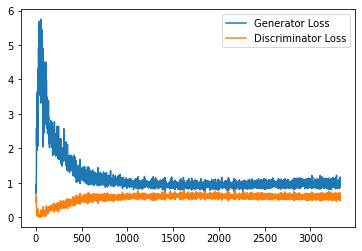

Step 67000: Generator loss: 0.9780545967817307, discriminator loss: 0.605058552980423


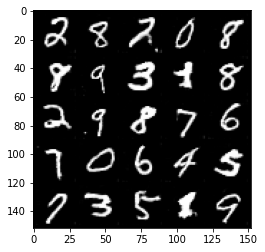

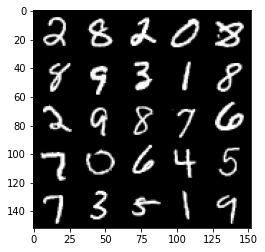

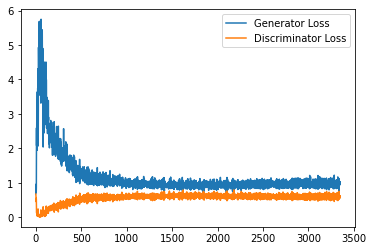

Step 67500: Generator loss: 0.9770575703382492, discriminator loss: 0.6086862000226975


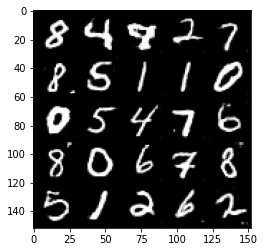

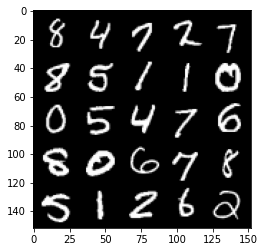

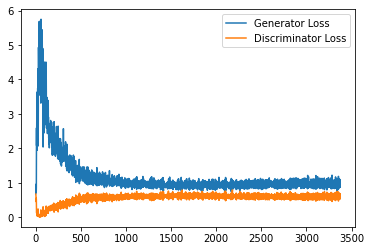

Step 68000: Generator loss: 0.9629761123657227, discriminator loss: 0.6126123412251473


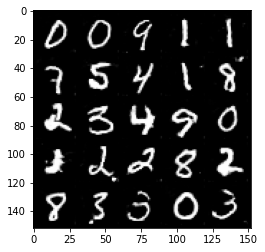

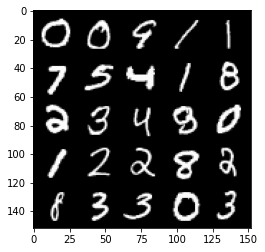

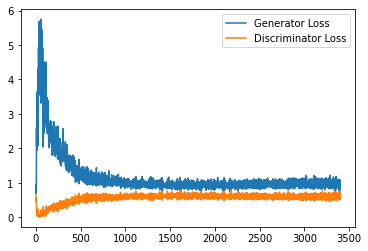

Step 68500: Generator loss: 0.9630666326284408, discriminator loss: 0.6035684531331063


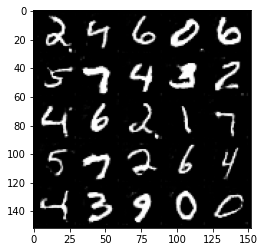

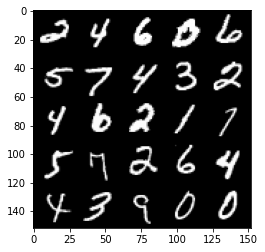

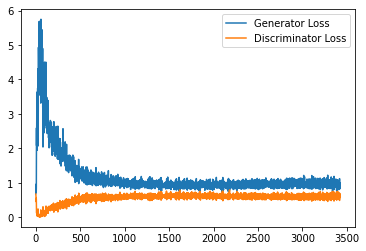

Step 69000: Generator loss: 0.9620346786975861, discriminator loss: 0.6010744535326957


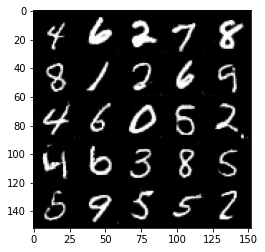

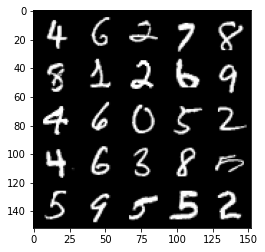

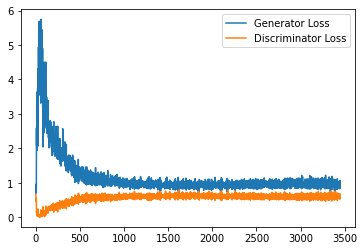

Step 69500: Generator loss: 0.9903411338329315, discriminator loss: 0.6013054212927819


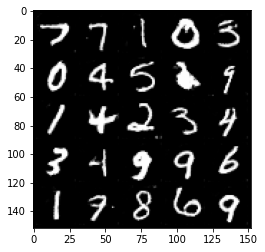

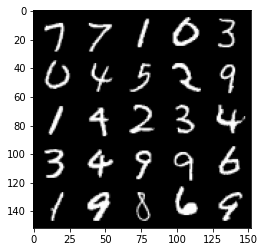

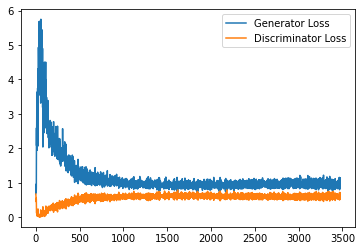

Step 70000: Generator loss: 0.9962435666322708, discriminator loss: 0.6051456550359726


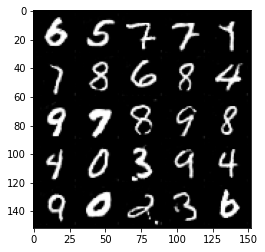

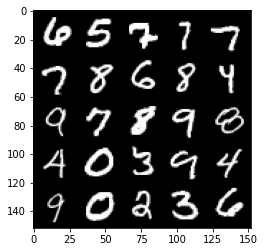

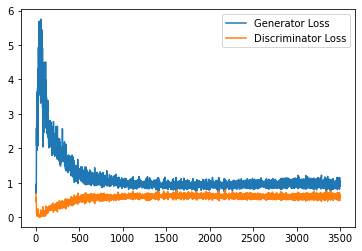

Step 70500: Generator loss: 0.9635566949844361, discriminator loss: 0.6083984044790268


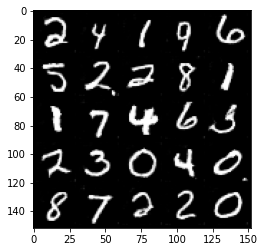

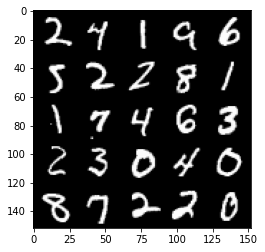

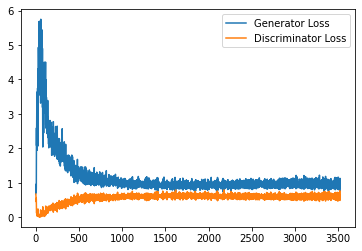

Step 71000: Generator loss: 0.9988887168169022, discriminator loss: 0.6073826709389687


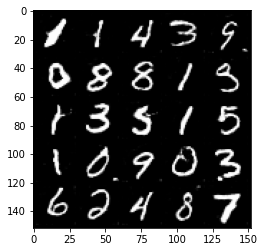

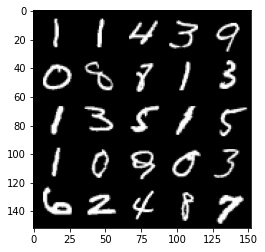

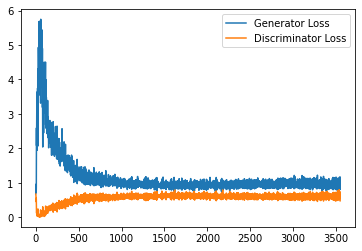

Step 71500: Generator loss: 0.9558127197027206, discriminator loss: 0.6114534977674484


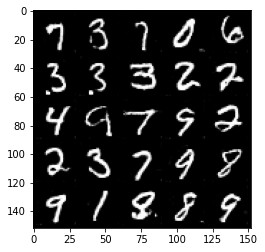

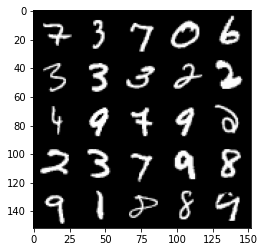

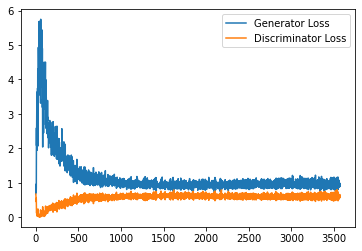

Step 72000: Generator loss: 0.9475266493558884, discriminator loss: 0.6084774770140647


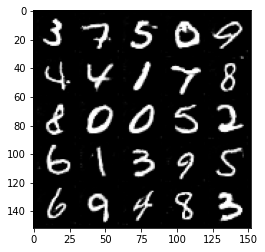

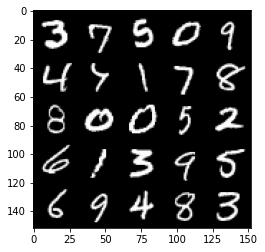

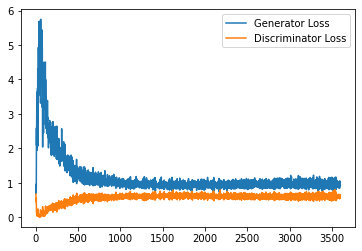

Step 72500: Generator loss: 0.9755072839260102, discriminator loss: 0.6094747423529625


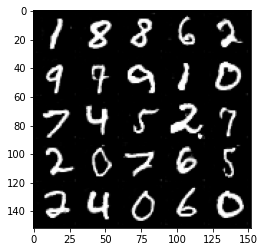

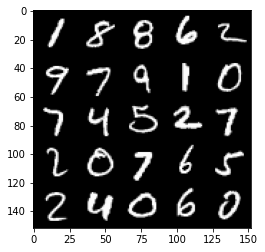

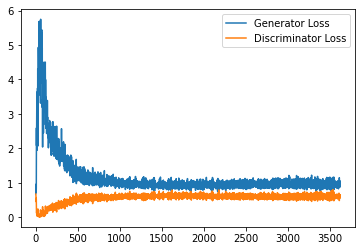

Step 73000: Generator loss: 0.9584334645271301, discriminator loss: 0.615280793249607


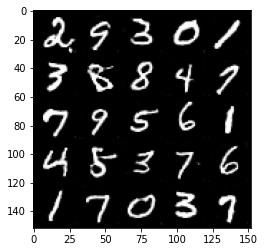

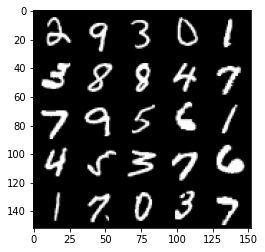

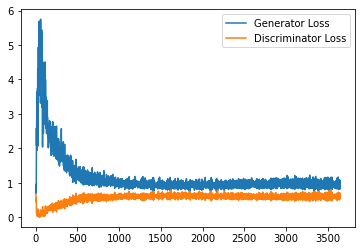

Step 73500: Generator loss: 0.9514256156682969, discriminator loss: 0.603982105910778


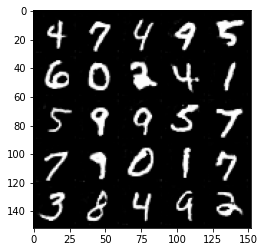

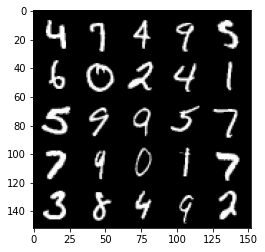

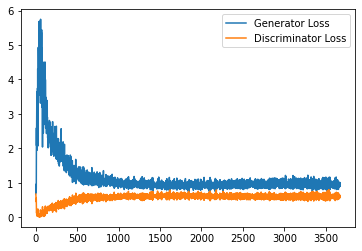

Step 74000: Generator loss: 0.9594051476716995, discriminator loss: 0.6209483552575111


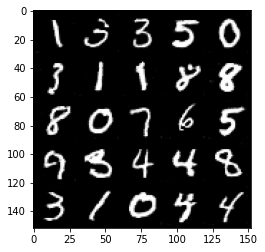

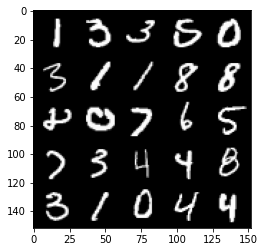

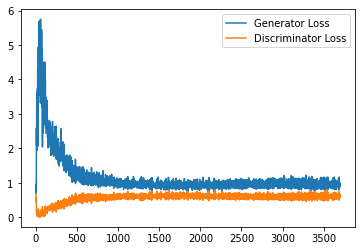

Step 74500: Generator loss: 0.9747979716062546, discriminator loss: 0.6110385289788246


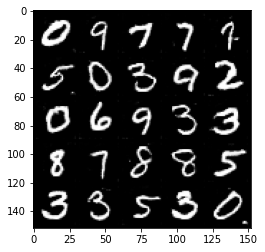

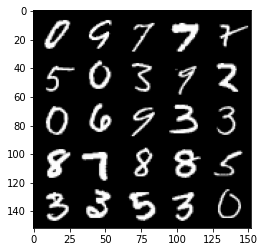

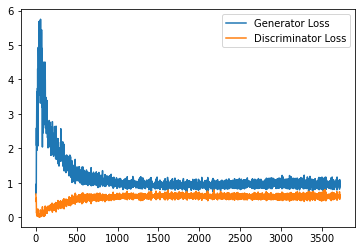

Step 75000: Generator loss: 0.9587251522541046, discriminator loss: 0.6100954701304435


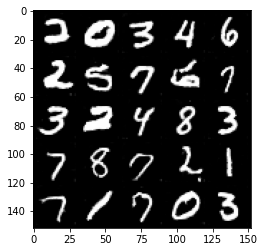

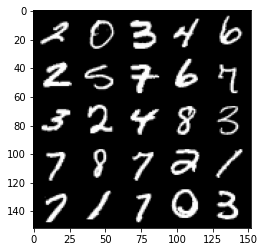

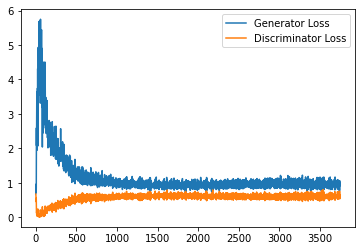

Step 75500: Generator loss: 0.9501470801830292, discriminator loss: 0.6125419909358024


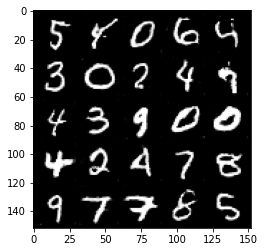

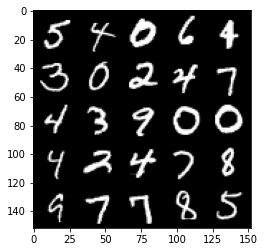

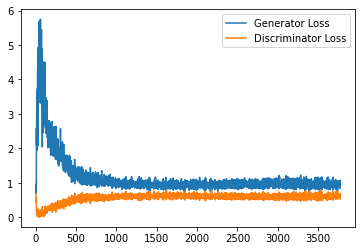

Step 76000: Generator loss: 0.9616141473054886, discriminator loss: 0.6119737673401833


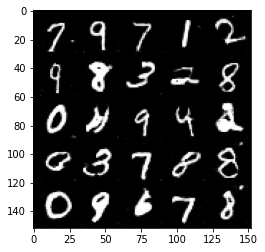

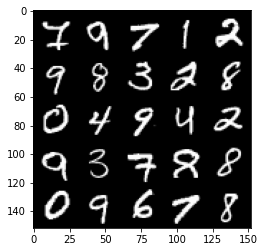

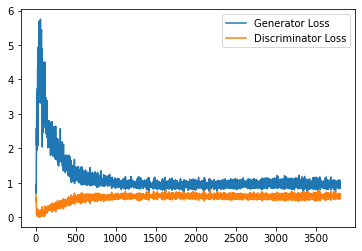

Step 76500: Generator loss: 0.9508892582654953, discriminator loss: 0.6141263386011123


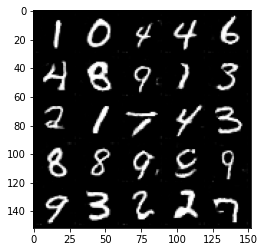

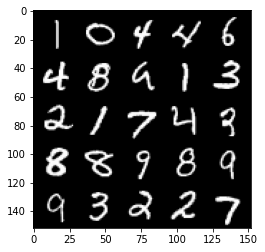

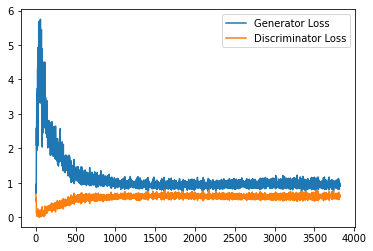

Step 77000: Generator loss: 0.9445439348220825, discriminator loss: 0.6176489979624749


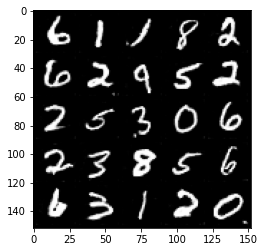

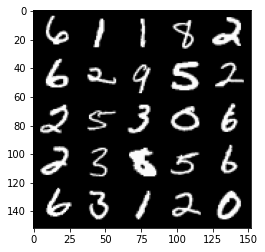

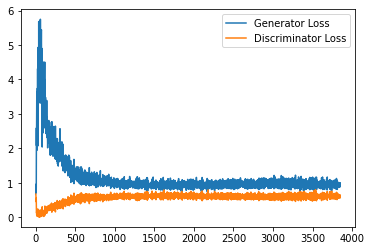

Step 77500: Generator loss: 0.9483494957685471, discriminator loss: 0.6124405546188354


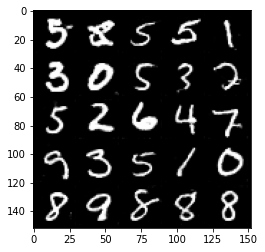

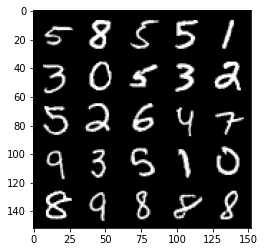

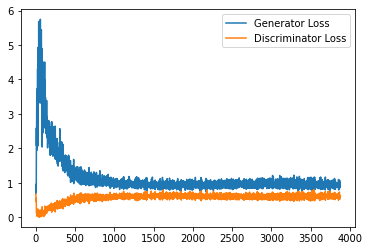

Step 78000: Generator loss: 0.9577059110403061, discriminator loss: 0.6156406158208847


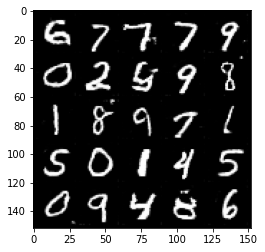

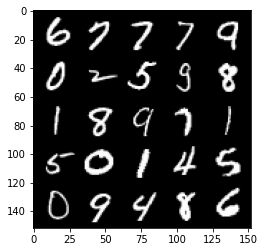

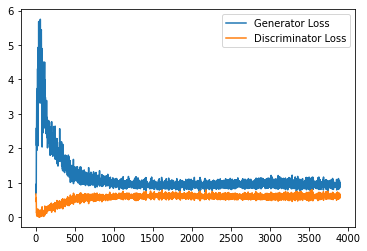

Step 78500: Generator loss: 0.9584316943883896, discriminator loss: 0.6139543399214744


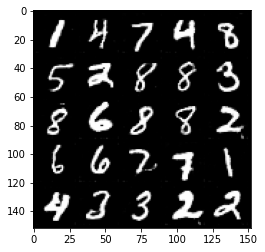

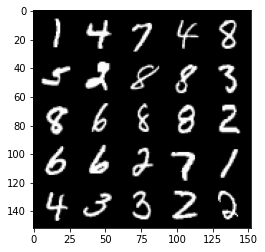

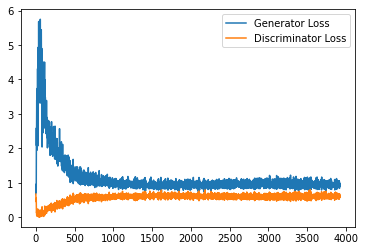

Step 79000: Generator loss: 0.945610331773758, discriminator loss: 0.6161930704116821


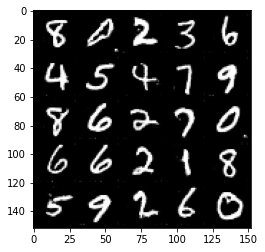

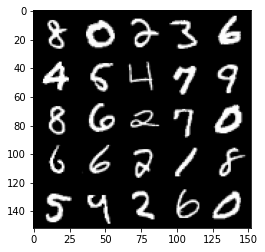

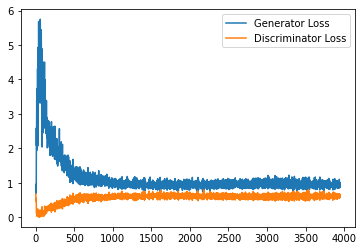

Step 79500: Generator loss: 0.9509000444412231, discriminator loss: 0.6158149106502533


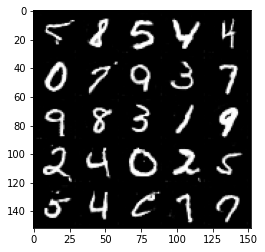

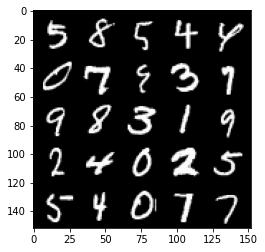

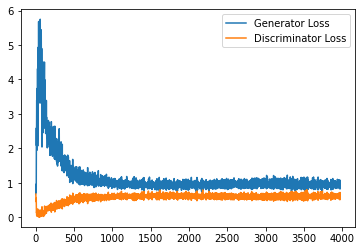

Step 80000: Generator loss: 0.936916297674179, discriminator loss: 0.6193862825036048


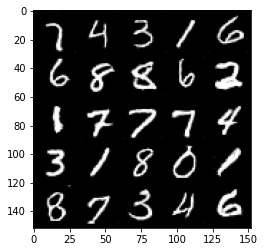

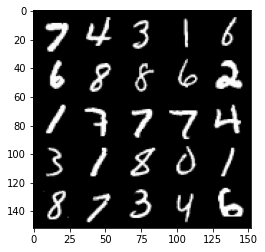

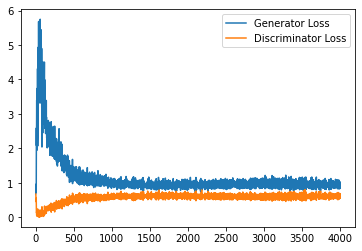

Step 80500: Generator loss: 0.955801168680191, discriminator loss: 0.6141804055571556


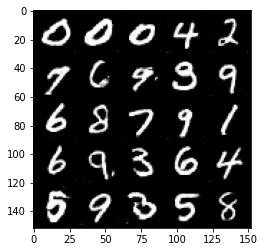

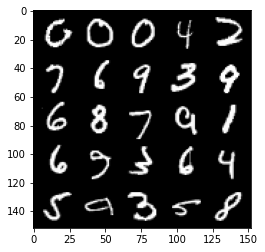

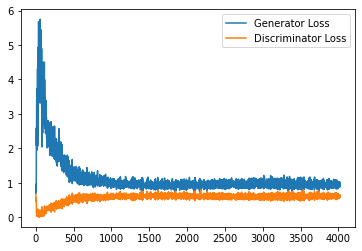

Step 81000: Generator loss: 0.9499302176237107, discriminator loss: 0.6217406328916549


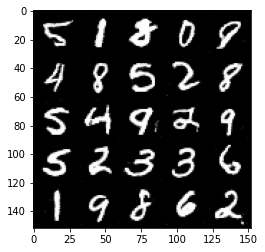

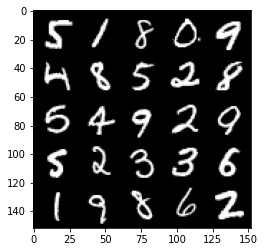

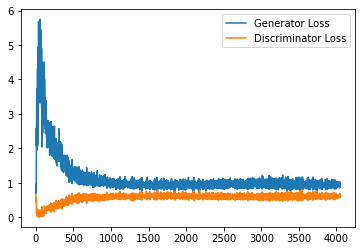

Step 81500: Generator loss: 0.94372705078125, discriminator loss: 0.6185388121008873


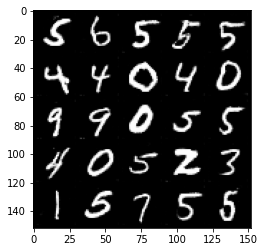

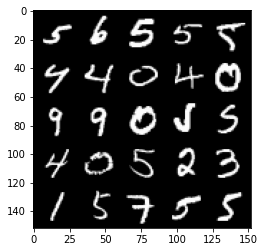

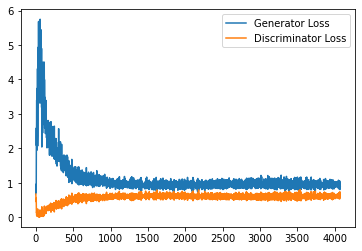

Step 82000: Generator loss: 0.9423797733783722, discriminator loss: 0.6208026658892631


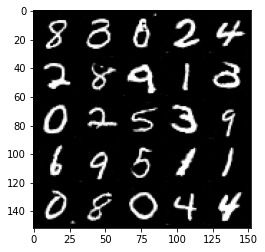

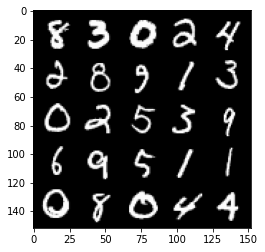

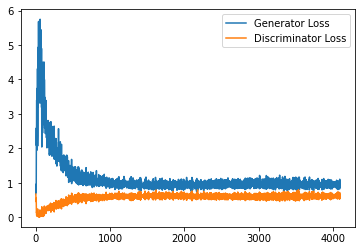

Step 82500: Generator loss: 0.9487468893527985, discriminator loss: 0.619066388964653


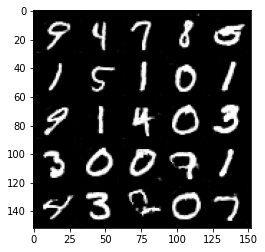

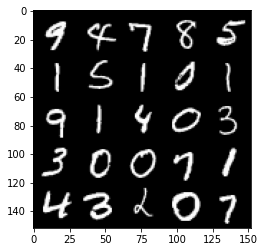

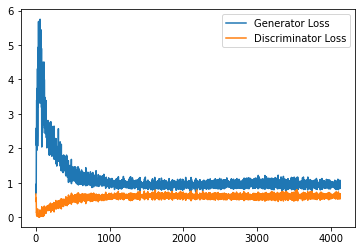

Step 83000: Generator loss: 0.9329349238872529, discriminator loss: 0.6211227428913116


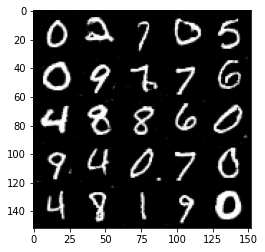

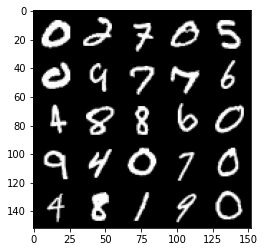

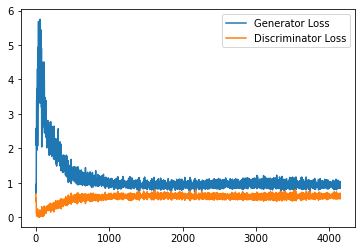

Step 83500: Generator loss: 0.9487224465608597, discriminator loss: 0.617744581758976


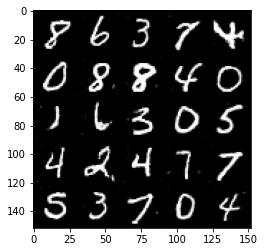

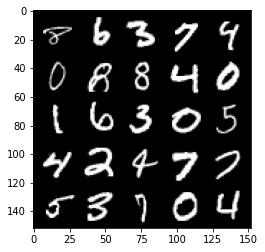

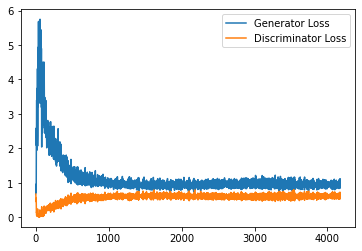

Step 84000: Generator loss: 0.9479179012775422, discriminator loss: 0.6227525118589401


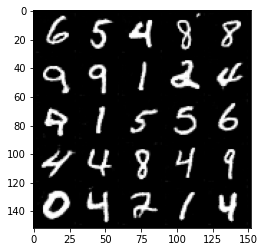

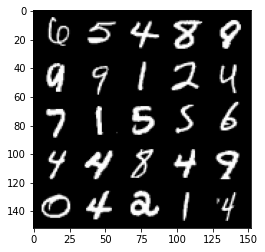

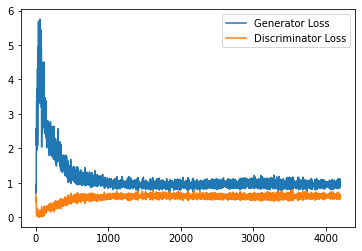

Step 84500: Generator loss: 0.9495312278270721, discriminator loss: 0.6236598248481751


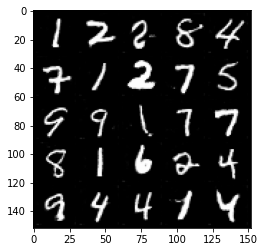

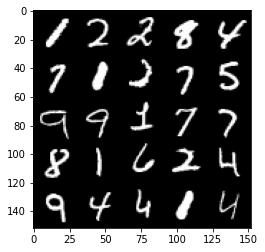

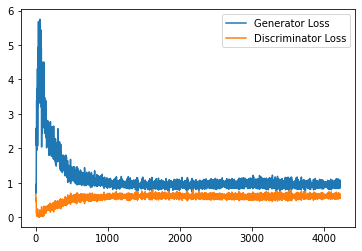

Step 85000: Generator loss: 0.9340545581579208, discriminator loss: 0.6202821877598762


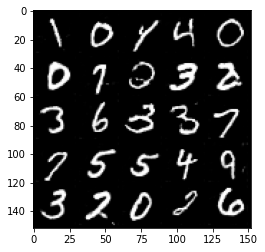

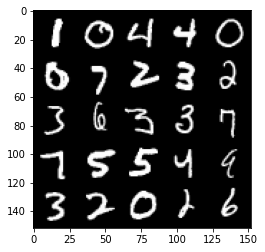

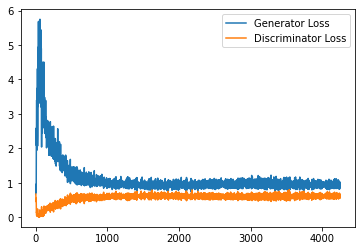

Step 85500: Generator loss: 0.9298242257833481, discriminator loss: 0.6212981443405151


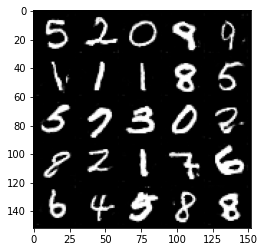

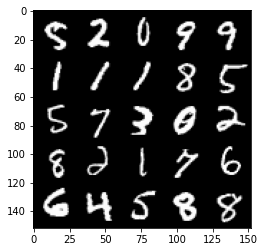

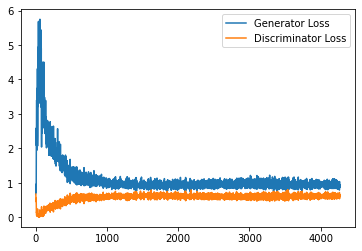

Step 86000: Generator loss: 0.9339834375381469, discriminator loss: 0.6273764258027077


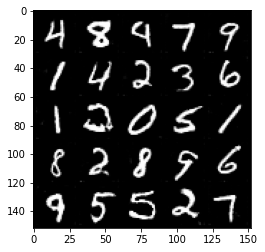

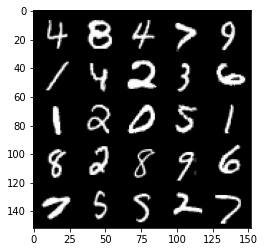

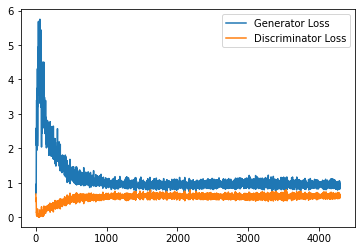

Step 86500: Generator loss: 0.9434205383062363, discriminator loss: 0.6245348585844039


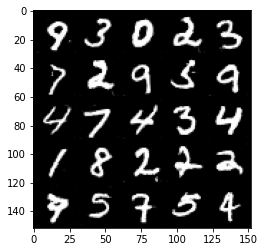

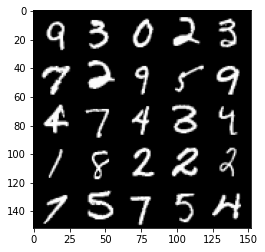

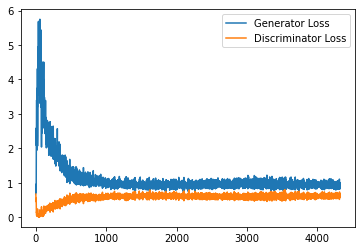

Step 87000: Generator loss: 0.9369351193904877, discriminator loss: 0.6270473747253418


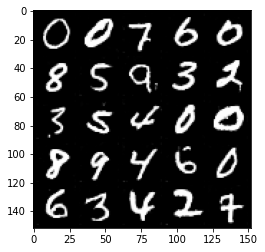

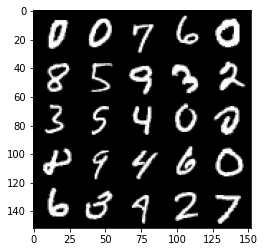

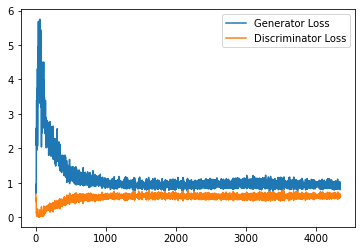

Step 87500: Generator loss: 0.9293937865495682, discriminator loss: 0.6215335484743119


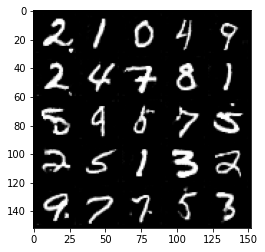

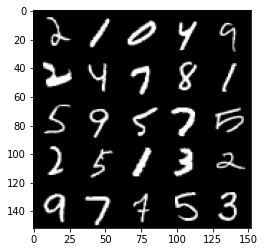

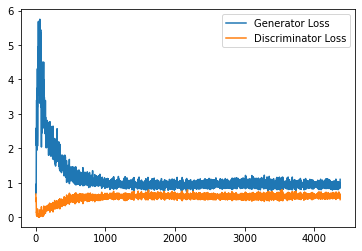

Step 88000: Generator loss: 0.9224610509872436, discriminator loss: 0.6271145181655884


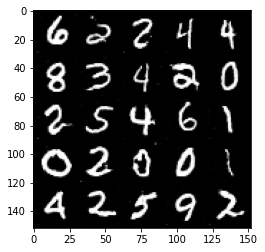

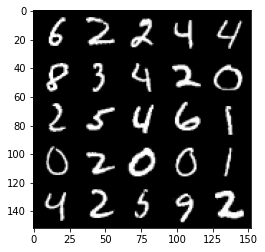

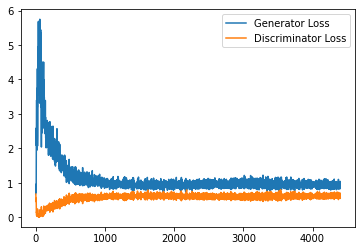

Step 88500: Generator loss: 0.9164070702791214, discriminator loss: 0.6314859846234322


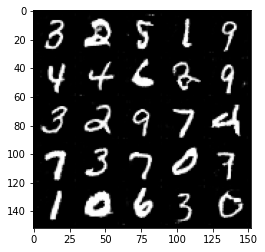

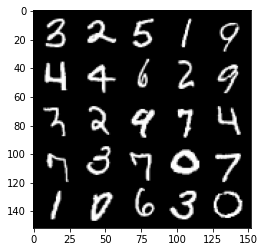

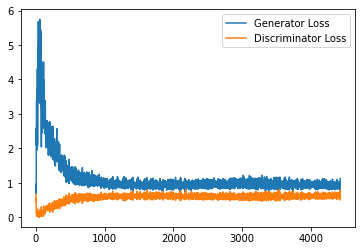

Step 89000: Generator loss: 0.9276948158740997, discriminator loss: 0.6320442532300949


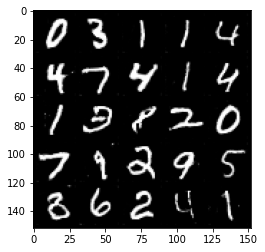

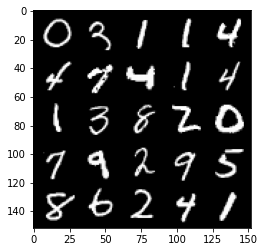

In [ ]:
# UNQ_C4 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED CELL
cur_step = 0
generator_losses = []
discriminator_losses = []

#UNIT TEST NOTE: Initializations needed for grading
noise_and_labels = False
fake = False

fake_image_and_labels = False
real_image_and_labels = False
disc_fake_pred = False
disc_real_pred = False

for epoch in range(n_epochs):
    # Dataloader returns the batches and the labels
    for real, labels in tqdm(dataloader):
        cur_batch_size = len(real)
        # Flatten the batch of real images from the dataset
        real = real.to(device)

        one_hot_labels = get_one_hot_labels(labels.to(device), n_classes)
        image_one_hot_labels = one_hot_labels[:, :, None, None]
        image_one_hot_labels = image_one_hot_labels.repeat(1, 1, mnist_shape[1], mnist_shape[2])

        ### Update discriminator ###
        # Zero out the discriminator gradients
        disc_opt.zero_grad()
        # Get noise corresponding to the current batch_size 
        fake_noise = get_noise(cur_batch_size, z_dim, device=device)
        
        # Now you can get the images from the generator
        # Steps: 1) Combine the noise vectors and the one-hot labels for the generator
        #        2) Generate the conditioned fake images
        
        #### START CODE HERE ####
        noise_and_labels = combine_vectors(fake_noise, one_hot_labels)
        fake = gen(noise_and_labels)
        #### END CODE HERE ####
        
        # Make sure that enough images were generated
        assert len(fake) == len(real)
        # Check that correct tensors were combined
        assert tuple(noise_and_labels.shape) == (cur_batch_size, fake_noise.shape[1] + one_hot_labels.shape[1])
        # It comes from the correct generator
        assert tuple(fake.shape) == (len(real), 1, 28, 28)

        # Now you can get the predictions from the discriminator
        # Steps: 1) Create the input for the discriminator
        #           a) Combine the fake images with image_one_hot_labels, 
        #              remember to detach the generator (.detach()) so you do not backpropagate through it
        #           b) Combine the real images with image_one_hot_labels
        #        2) Get the discriminator's prediction on the fakes as disc_fake_pred
        #        3) Get the discriminator's prediction on the reals as disc_real_pred
        
        #### START CODE HERE ####
        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        real_image_and_labels = combine_vectors(real, image_one_hot_labels)
        disc_fake_pred = disc(fake_image_and_labels.detach())
        disc_real_pred = disc(real_image_and_labels)
        #### END CODE HERE ####
        
        # Make sure shapes are correct 
        assert tuple(fake_image_and_labels.shape) == (len(real), fake.detach().shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        assert tuple(real_image_and_labels.shape) == (len(real), real.shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        # Make sure that enough predictions were made
        assert len(disc_real_pred) == len(real)
        # Make sure that the inputs are different
        assert torch.any(fake_image_and_labels != real_image_and_labels)
        # Shapes must match
        assert tuple(fake_image_and_labels.shape) == tuple(real_image_and_labels.shape)
        assert tuple(disc_fake_pred.shape) == tuple(disc_real_pred.shape)
        
        
        disc_fake_loss = criterion(disc_fake_pred, torch.zeros_like(disc_fake_pred))
        disc_real_loss = criterion(disc_real_pred, torch.ones_like(disc_real_pred))
        disc_loss = (disc_fake_loss + disc_real_loss) / 2
        disc_loss.backward(retain_graph=True)
        disc_opt.step() 

        # Keep track of the average discriminator loss
        discriminator_losses += [disc_loss.item()]

        ### Update generator ###
        # Zero out the generator gradients
        gen_opt.zero_grad()

        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        # This will error if you didn't concatenate your labels to your image correctly
        disc_fake_pred = disc(fake_image_and_labels)
        gen_loss = criterion(disc_fake_pred, torch.ones_like(disc_fake_pred))
        gen_loss.backward()
        gen_opt.step()

        # Keep track of the generator losses
        generator_losses += [gen_loss.item()]
        #

        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            disc_mean = sum(discriminator_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, discriminator loss: {disc_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            x_axis = sorted([i * step_bins for i in range(len(generator_losses) // step_bins)] * step_bins)
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(discriminator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Discriminator Loss"
            )
            plt.legend()
            plt.show()
        elif cur_step == 0:
            print("Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!")
        cur_step += 1

## Exploration
You can do a bit of exploration now!

In [ ]:
# Before you explore, you should put the generator
# in eval mode, both in general and so that batch norm
# doesn't cause you issues and is using its eval statistics
gen = gen.eval()

#### Changing the Class Vector
You can generate some numbers with your new model! You can add interpolation as well to make it more interesting.

So starting from a image, you will produce intermediate images that look more and more like the ending image until you get to the final image. Your're basically morphing one image into another. You can choose what these two images will be using your conditional GAN.

In [ ]:
import math

### Change me! ###
n_interpolation = 9 # Choose the interpolation: how many intermediate images you want + 2 (for the start and end image)
interpolation_noise = get_noise(1, z_dim, device=device).repeat(n_interpolation, 1)

def interpolate_class(first_number, second_number):
    first_label = get_one_hot_labels(torch.Tensor([first_number]).long(), n_classes)
    second_label = get_one_hot_labels(torch.Tensor([second_number]).long(), n_classes)

    # Calculate the interpolation vector between the two labels
    percent_second_label = torch.linspace(0, 1, n_interpolation)[:, None]
    interpolation_labels = first_label * (1 - percent_second_label) + second_label * percent_second_label

    # Combine the noise and the labels
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_labels.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

### Change me! ###
start_plot_number = 1 # Choose the start digit
### Change me! ###
end_plot_number = 5 # Choose the end digit

plt.figure(figsize=(8, 8))
interpolate_class(start_plot_number, end_plot_number)
_ = plt.axis('off')

### Uncomment the following lines of code if you would like to visualize a set of pairwise class 
### interpolations for a collection of different numbers, all in a single grid of interpolations.
### You'll also see another visualization like this in the next code block!
# plot_numbers = [2, 3, 4, 5, 7]
# n_numbers = len(plot_numbers)
# plt.figure(figsize=(8, 8))
# for i, first_plot_number in enumerate(plot_numbers):
#     for j, second_plot_number in enumerate(plot_numbers):
#         plt.subplot(n_numbers, n_numbers, i * n_numbers + j + 1)
#         interpolate_class(first_plot_number, second_plot_number)
#         plt.axis('off')
# plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
# plt.show()
# plt.close()

#### Changing the Noise Vector
Now, what happens if you hold the class constant, but instead you change the noise vector? You can also interpolate the noise vector and generate an image at each step.

In [ ]:
n_interpolation = 9 # How many intermediate images you want + 2 (for the start and end image)

# This time you're interpolating between the noise instead of the labels
interpolation_label = get_one_hot_labels(torch.Tensor([5]).long(), n_classes).repeat(n_interpolation, 1).float()

def interpolate_noise(first_noise, second_noise):
    # This time you're interpolating between the noise instead of the labels
    percent_first_noise = torch.linspace(0, 1, n_interpolation)[:, None].to(device)
    interpolation_noise = first_noise * percent_first_noise + second_noise * (1 - percent_first_noise)

    # Combine the noise and the labels again
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_label.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

# Generate noise vectors to interpolate between
### Change me! ###
n_noise = 5 # Choose the number of noise examples in the grid
plot_noises = [get_noise(1, z_dim, device=device) for i in range(n_noise)]
plt.figure(figsize=(8, 8))
for i, first_plot_noise in enumerate(plot_noises):
    for j, second_plot_noise in enumerate(plot_noises):
        plt.subplot(n_noise, n_noise, i * n_noise + j + 1)
        interpolate_noise(first_plot_noise, second_plot_noise)
        plt.axis('off')
plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
plt.show()
plt.close()